## Refine B cell annotations for large intestine - relabelling uncertain cells based on manual inspection/majority voting

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [2]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [4]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)

In [5]:
sns.set_style(style="white")
sns.set_context(context="paper")

### Import

In [6]:
#import data
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/compartments/Bcells_pooled_disease.gene_cellbender.good_qc_cluster_mito80.stringent_doublet_removed.hvg7500_noCC.scvi_output.lv20_batch256.with_raw_counts.scArches_broad_pred.20230124.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 106472 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [8]:
#import scanvi coordinates
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/X_scANVI/disease/disease_fine_annot_predict_B_20230226.csv.gz',compression='gzip',index_col=0)

In [9]:
adata_scanvi

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
index,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGGTTAT-4918STDY7273964,-0.182853,-0.055051,0.129861,0.010175,-0.358423,0.012688,-0.329064,0.552721,-0.219694,0.421622,-0.146920,-0.109510,-0.119088,-0.071079,-0.039918,0.306495,1.384495,-0.308633,-1.313650,-0.240896
AAACGGGAGAGCTGGT-4918STDY7273964,0.032228,-0.127286,0.088927,0.096875,0.104098,-0.001083,-0.413132,0.336256,-0.137968,0.378295,-0.130219,-0.096623,-0.307476,-0.075311,-0.077002,0.284345,1.263840,-0.666570,-1.690922,-0.103627
AAACGGGCACTAAGTC-4918STDY7273964,0.165797,0.025699,0.026137,0.075255,-0.259465,-0.026657,-0.135315,0.845352,0.000211,0.122731,-0.128680,-0.094996,-0.302314,-0.033069,-0.096825,-0.229130,1.625613,-0.263917,-1.360457,0.082305
AAACGGGGTAAAGGAG-4918STDY7273964,-0.428445,0.874057,-0.080057,0.509662,0.086164,0.104386,0.018512,-1.429693,-0.099613,0.137998,-0.154342,-0.098822,0.202240,-0.041588,0.063394,-0.774859,1.414233,0.657751,0.413062,-0.467742
AAACGGGGTAGCGATG-4918STDY7273964,-0.110093,-0.326858,0.090055,0.050834,-0.329513,0.043639,-0.046950,0.507594,0.047527,0.189970,-0.095063,-0.107143,-0.154675,-0.017247,-0.068661,0.066715,1.754218,-1.010220,-1.447902,-0.072917
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCGTCTGATTG-GSM4546346,0.000742,0.048535,0.045700,0.035928,-0.440970,0.038812,0.507420,-0.185946,-0.639484,-0.004300,-0.058265,-0.107927,-0.343886,0.025337,-0.057391,0.865286,-1.092341,-1.042674,-0.770732,0.462946
TTTGCGCTCATTGCCC-GSM4546346,1.150696,0.047837,-0.210524,0.126120,-0.050555,0.101302,0.239386,0.139913,-0.462801,-0.165851,0.093769,-0.085959,-0.291848,0.034110,-0.047429,0.971700,-1.306548,-0.222307,0.274713,0.100808
TTTGGTTGTACCTACA-GSM4546346,-0.216642,1.216335,-0.028942,0.059733,-0.319058,0.141362,0.232176,-0.251235,1.707904,0.287929,-0.042562,-0.128562,0.571779,0.074669,-0.110403,-1.657449,-1.009002,-0.829511,-0.546240,-0.284610


In [10]:
adata.obsm['X_scANVI'] = adata_scanvi

In [13]:
#import metadata
adata_meta = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/20230308/scanvi/disease_fine_annot_predict_B_20230226.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (73,82,83,84,86,93,100) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [14]:
adata_meta

,latent_cell_probability,latent_RT_efficiency,cecilia22_predH,cecilia22_predH_prob,cecilia22_predH_uncertain,cecilia22_predL,cecilia22_predL_prob,cecilia22_predL_uncertain,elmentaite21_pred,elmentaite21_pred_prob,...,martin19_pred_uncertain,warner20_pred,warner20_pred_prob,warner20_pred_uncertain,broad_predicted_labels,broad_predicted_labels_uncert,fine_annot,fine_predicted_labels,fine_predicted_labels_uncertainty,scanvi_pred
index,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGGTTAT-4918STDY7273964,0.999636,1.277868,B cells,0.999935,B cells,Naive B cells,0.532800,Naive B cells,Naive B,0.997290,...,B naive,Th,0.269990,Uncertain,B and B plasma,1.192093e-07,Unknown,B_naive,0.079999,B_naive
AAACGGGAGAGCTGGT-4918STDY7273964,0.999145,1.139521,B cells,0.999925,B cells,Naive B cells,0.999827,Naive B cells,Naive B,0.990829,...,B naive,Th,0.298665,Uncertain,B and B plasma,0.000000e+00,Unknown,B_naive,0.020000,B_naive
AAACGGGCACTAAGTC-4918STDY7273964,0.999503,1.281189,B cells,0.999567,B cells,Naive B cells,0.964691,Naive B cells,Naive B,0.998023,...,B naive,Th,0.355680,Th,B and B plasma,0.000000e+00,Unknown,B_naive,0.080000,B_naive
AAACGGGGTAAAGGAG-4918STDY7273964,0.999479,0.905393,B cells,0.991974,B cells,Germinal center B cells,0.171578,Uncertain,Cycling B cell,0.956816,...,B cycling,B,0.249146,Uncertain,B and B plasma,0.000000e+00,Unknown,B_GC_II,0.360002,B_GC_II
AAACGGGGTAGCGATG-4918STDY7273964,0.999532,1.190154,B cells,0.999998,B cells,Naive B cells,0.913556,Naive B cells,Naive B,0.994631,...,B naive,B,0.322891,B,B and B plasma,1.192093e-07,Unknown,B_naive,0.020000,B_naive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCGTCTGATTG-GSM4546346,0.999901,1.726214,Plasma cells,0.999993,Plasma cells,Plasma cells,0.999882,Plasma cells,IgA plasma cell,0.672541,...,Plasma IgM,Plasma,0.999327,Plasma,B and B plasma,0.000000e+00,Unknown,B_plasma_IgA1,0.099998,B_proB
TTTGCGCTCATTGCCC-GSM4546346,0.999707,1.031985,Plasma cells,0.999940,Plasma cells,Plasma cells,0.998641,Plasma cells,IgA plasma cell,0.934680,...,Plasma IgM,Plasma,0.993124,Plasma,B and B plasma,1.192093e-07,Unknown,B_plasma_IgA1,0.260000,B_plasma_IgA1
TTTGGTTGTACCTACA-GSM4546346,0.999942,2.202289,Plasma cells,0.999890,Plasma cells,Plasma cells,0.999779,Plasma cells,IgG plasma cell,0.979074,...,Plasma IgG,Plasma,0.998877,Plasma,B and B plasma,0.000000e+00,Unknown,B_plasma_IgG,0.080000,B_plasma_IgG


In [15]:
adata.obs = adata_meta

### Process

In [16]:
#compute neighbours and umap
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


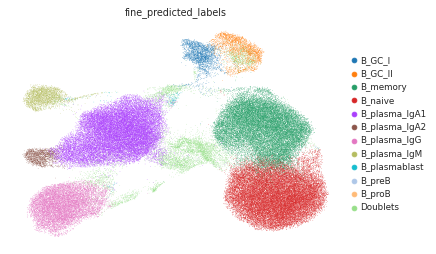

In [17]:
sc.pl.umap(adata, color=['fine_predicted_labels'])

In [18]:
adata.obs.donor_disease.unique()

['PIBD', 'cancer', 'UC', 'CD']
Categories (4, object): ['CD', 'PIBD', 'UC', 'cancer']

In [19]:
#fix metadata
adata.obs['disease'] = adata.obs['donor_category'].astype(str) + '_' + adata.obs['donor_disease'].astype(str)

In [20]:
list(adata.obs.disease.unique())

['disease_PIBD', 'disease_cancer', 'disease_UC', 'disease_CD']

In [21]:
adata.obs.disease.value_counts()

disease_cancer    45450
disease_PIBD      33019
disease_UC        16438
disease_CD        11565
Name: disease, dtype: int64

In [22]:
adata.obs.donor_disease.unique()

['PIBD', 'cancer', 'UC', 'CD']
Categories (4, object): ['CD', 'PIBD', 'UC', 'cancer']

In [23]:
adata.obs['disease'] = (adata.obs['disease'].map(lambda x:{
'disease_cancer':'cancer',
    'disease_PIBD':'pediatric_IBD',
    'disease_UC':'ulcertaive_colitis',
    'disease_CD':'crohns_disease'
    }.get(x,x)).astype("category"))

In [24]:
cancer = adata[adata.obs['disease'].isin(['cancer'])].copy()

In [25]:
cancer.obs.disease.value_counts()

cancer    45450
Name: disease, dtype: int64

In [26]:
cancer.obs['disease'] = cancer.obs['disease'].astype(str) + '_' + cancer.obs['organ_unified'].astype(str)

In [27]:
cancer.obs.disease.value_counts()

cancer_stomach            39471
cancer_colon               3470
cancer_rectum              1642
cancer_sigmoid colon        428
cancer_ascending colon      408
cancer_caecum                31
Name: disease, dtype: int64

In [28]:
cancer.obs['disease'] = (cancer.obs['disease'].map(lambda x:{'cancer_caecum':'cancer_colorectal',
 'cancer_rectum':'cancer_colorectal',
 'cancer_sigmoid colon':'cancer_colorectal',
 'cancer_colon':'cancer_colorectal',
 'cancer_ascending colon':'cancer_colorectal',
 'cancer_stomach':'cancer_gastric'}.get(x,x)).astype("category"))

In [29]:
cancer.obs.disease.value_counts()

cancer_gastric       39471
cancer_colorectal     5979
Name: disease, dtype: int64

In [30]:
ON = {O:N for O,N in zip(cancer.obs_names,cancer.obs["disease"])}
adata.obs["disease"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["disease"])]
adata.obs.disease.value_counts()

cancer_gastric        39471
pediatric_IBD         33019
ulcertaive_colitis    16438
crohns_disease        11565
cancer_colorectal      5979
Name: disease, dtype: int64

In [31]:
list(adata.obs.disease.unique())

['pediatric_IBD',
 'cancer_colorectal',
 'ulcertaive_colitis',
 'crohns_disease',
 'cancer_gastric']

In [32]:
adata.obs['disease'] = adata.obs['disease'].astype('category')

In [33]:
adata.obs['disease'] = (adata.obs['disease'].map(lambda x:{'ulcertaive_colitis':'ulcerative_colitis'}.get(x,x)).astype("category"))

In [34]:
adata.obs['disease'].cat.reorder_categories([
 'crohns_disease',
 'ulcerative_colitis',
 'pediatric_IBD',
 'cancer_colorectal',
 'cancer_gastric'], inplace=True)

<ipython-input-34-b0e974b68020>:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['disease'].cat.reorder_categories([


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


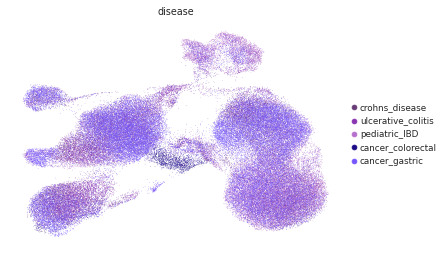

In [35]:
#plot umaps
sc.pl.umap(adata,color = 'disease',palette=[#'#ADD3DD',#control
                                    #'#ffb7b7',#'inutero',
                                     #'#f48154',#'preterm',
                                    '#693C78',#crohn's disease
                                            '#8934B1',#UC
                                            '#B670CD',#PIBD
                                            '#1C0B86',#colorectal cancer
                                            '#7657ff',#gastric cancer
                                           ])

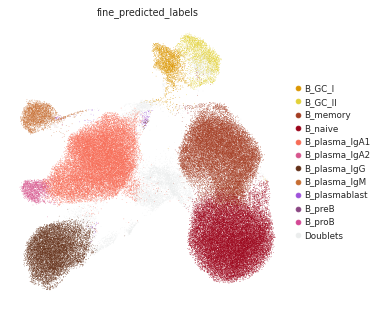

In [37]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels',palette = ['#db9602', #B_GC_I
'#e2d138', #B_GC_II
'#a33c22',#B_memory
'#9b0319', #B_naive
'#f76c56',#B_plasma_IgA1
'#d6558d',#B_plasma_IgA2
'#632f17',#B_plasma_IgG                            
'#c66d31',#B_plasma_IgM
'#9e53db',#B_plasmablast
'#8a4682',#B_preB
'#d34794',#pro b
                                                            '#ebeded',#doublets
                                                          
                                                         ],size=1.5)

In [38]:
adata.X.max()

46501.0

In [39]:
adata.layers['counts'] = adata.X

In [40]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [41]:
marker_genes_dict = {'General B cell markers':['CD79A','CD79B','CD19','HLA-DRA','HLA-DRB1','MS4A1'],
                     'Germinal centre B cells':['MKI67','AICDA','BCL6','SUGCT'],
                    'Memory B cells':['CD27','TNFRSF13B'],
                     'Naive B cells':['SELL','TCL1A','IGHD'],
                     'General Plasma cell markers':['MZB1','XBP1'],
                     'IgA plasma cells':['IGHA1','IGHA2'],
                     'IgG plasma cells':['IGHG3','IGHG1','IGHG2','IGHG4'],
                     'IgM plasma cells':['IGHM'],
                     'Pre/proB cells':['SPIB','CD37','IGLL1','RAG1','DNTT','VPREB3']}

In [42]:
adata

AnnData object with n_obs × n_vars = 106472 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


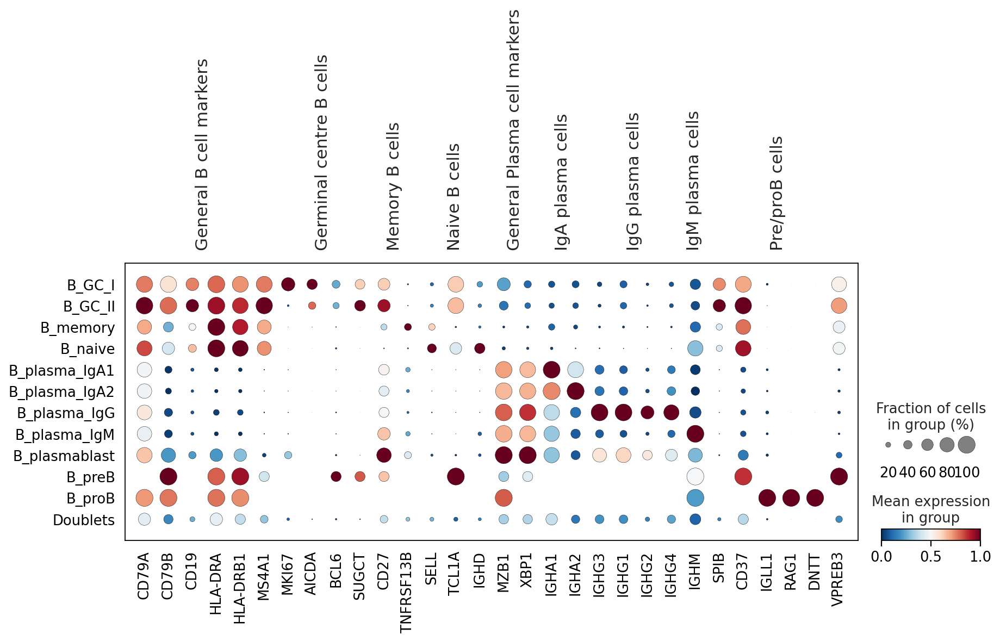

In [43]:
#plot markers
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var')

### Define uncertain cells

In [44]:
uncert = adata.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']] 

In [45]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(adata.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.37998234629631045


(array([2.8830e+04, 1.2142e+04, 9.6530e+03, 7.7610e+03, 1.1421e+04,
        4.0730e+03, 3.4040e+03, 2.7510e+03, 4.6680e+03, 1.9540e+03,
        1.7160e+03, 1.6230e+03, 2.9840e+03, 1.3120e+03, 1.3680e+03,
        1.3120e+03, 1.1470e+03, 2.4290e+03, 1.2120e+03, 1.1570e+03,
        1.0550e+03, 1.2300e+03, 4.2500e+02, 2.9300e+02, 1.9500e+02,
        2.5200e+02, 5.7000e+01, 2.3000e+01, 1.7000e+01, 8.0000e+00]),
 array([0.        , 0.02466654, 0.04933308, 0.07399962, 0.09866616,
        0.1233327 , 0.14799924, 0.17266578, 0.19733232, 0.22199886,
        0.2466654 , 0.27133194, 0.29599848, 0.32066502, 0.34533156,
        0.3699981 , 0.39466464, 0.41933118, 0.44399772, 0.46866426,
        0.4933308 , 0.51799734, 0.54266388, 0.56733042, 0.59199696,
        0.6166635 , 0.64133004, 0.66599658, 0.69066312, 0.71532966,
        0.73999619]),
 <BarContainer object of 30 artists>)

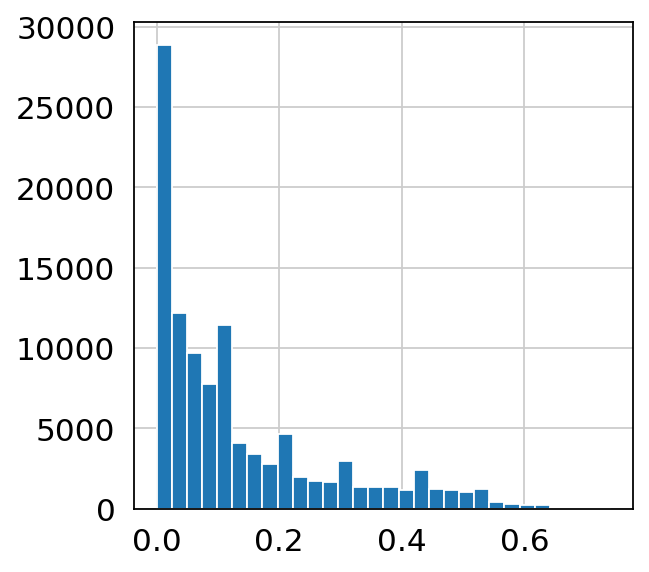

In [46]:
#plot uncertainty distribution
plt.hist(adata.obs['fine_predicted_labels_uncertainty'], bins=30)

In [47]:
uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-47-905f2ed234d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')


In [48]:
adata.obs['fine_predicted_labels'].unique()

['B_naive', 'B_GC_II', 'B_memory', 'Doublets', 'B_GC_I', ..., 'B_plasma_IgM', 'B_plasmablast', 'B_plasma_IgA2', 'B_proB', 'B_preB']
Length: 12
Categories (12, object): ['B_GC_I', 'B_GC_II', 'B_memory', 'B_naive', ..., 'B_plasmablast', 'B_preB', 'B_proB', 'Doublets']

In [49]:
#mark cells are unknown based on cut off of 90th percentile
uncert.loc[uncert["fine_predicted_labels_uncertainty"] > p, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [50]:
adata.obs['fine_predicted_labels_uncertflagged'] = adata.obs['fine_predicted_labels']

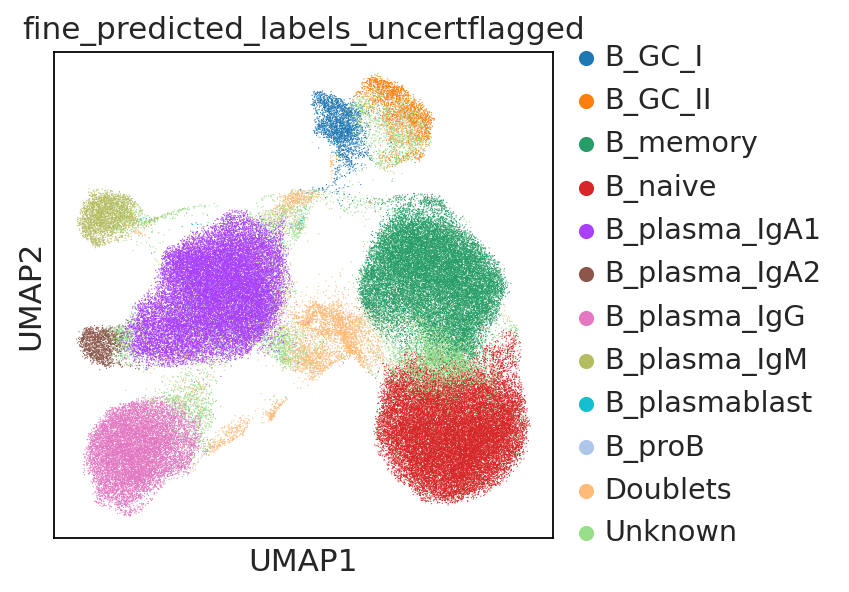

In [51]:
ON = {O:N for O,N in zip(uncert.index,uncert["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged')

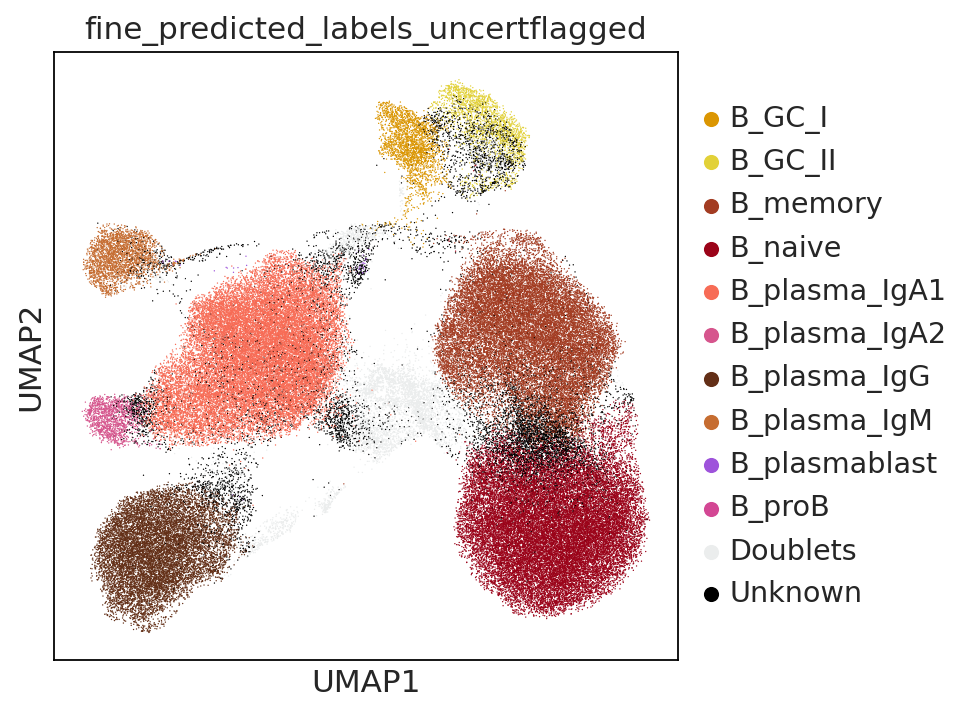

In [53]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = ['#db9602', #B_GC_I
'#e2d138', #B_GC_II
'#a33c22',#B_memory
'#9b0319', #B_naive
'#f76c56',#B_plasma_IgA1
'#d6558d',#B_plasma_IgA2
'#632f17',#B_plasma_IgG                            
'#c66d31',#B_plasma_IgM
'#9e53db',#B_plasmablast
#'#8a4682',#B_preB
'#d34794',#pro b
                                                            '#ebeded',#doublets
                                                                        '#000000'#unknown
                                                       
                                               
                                               
    
    
                                              ],size=1.5)

### Finalise annotations
- calculate leiden clusters
- inspect annotations across leiden clusters
- assess marker genes, doublet markers, donor distribution
- relabel based on majority voting of leiden clusters, along with confirmation from marker genes etc.

In [54]:
#reassign labels for unknown cells by leiden clustering and majority voting
sc.tl.leiden(adata,resolution=1,key_added='leiden1')

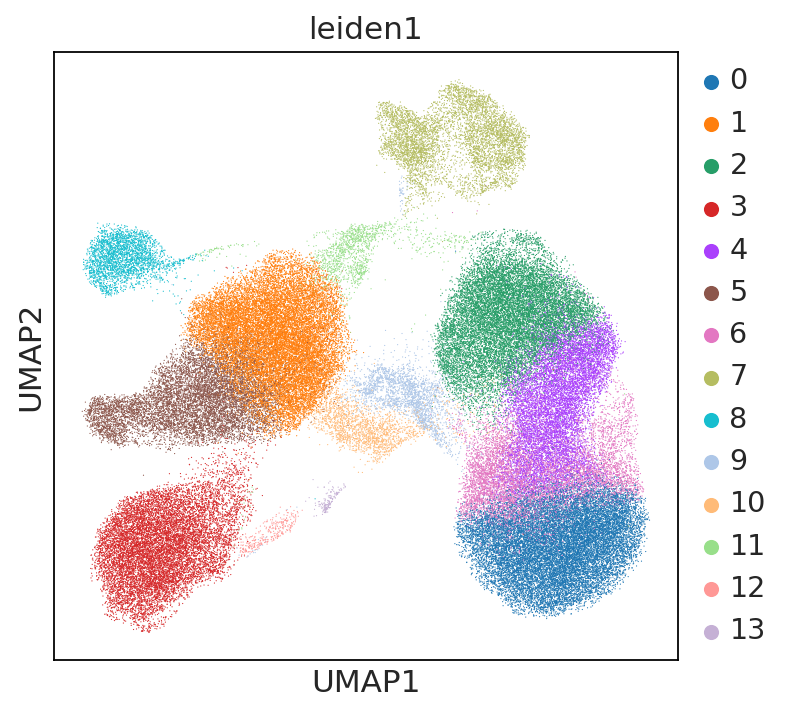

In [55]:
sc.pl.umap(adata,color='leiden1')

In [56]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,B_GC_I,B_GC_II,B_memory,B_naive,B_plasma_IgA1,B_plasma_IgA2,B_plasma_IgG,B_plasma_IgM,B_plasmablast,B_proB,Doublets,Unknown
leiden1,,,,,,,,,,,,
0,0,0,3,18019,0,0,0,0,0,0,11,283
1,0,0,0,0,17266,0,0,0,0,1,128,777
2,0,0,14443,5,1,0,0,0,0,0,48,434
3,0,0,0,0,14,0,11063,0,8,0,149,795
4,0,0,6401,1209,0,0,0,0,0,0,53,2707
5,0,0,0,0,7077,1385,0,0,0,0,108,841
6,0,0,167,6675,0,0,0,0,0,0,90,1140
7,2209,1942,4,4,4,0,0,0,0,0,266,1213
8,0,0,0,0,1,0,0,2508,11,0,51,271


In [57]:
unknown = adata.obs[['leiden1','fine_predicted_labels_uncertflagged']]

In [58]:
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [59]:
unknown

,leiden1,fine_predicted_labels_uncertflagged
index,,
AAACGGGTCCTGTAGA-4918STDY7273964,9,Unknown
AAAGATGTCAACGAAA-4918STDY7273964,7,Unknown
AAAGCAAGTGTTTGGT-4918STDY7273964,10,Unknown
AACACGTAGTTCCACA-4918STDY7273964,4,Unknown
AACCATGCAATCACAC-4918STDY7273964,0,Unknown
...,...,...
TAGAGCTCATTGGGCC-GSM4546346,6,Unknown
TGGACGCGTATAGGGC-GSM4546346,5,Unknown
TGGGCGTTCCGCAAGC-GSM4546346,5,Unknown


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


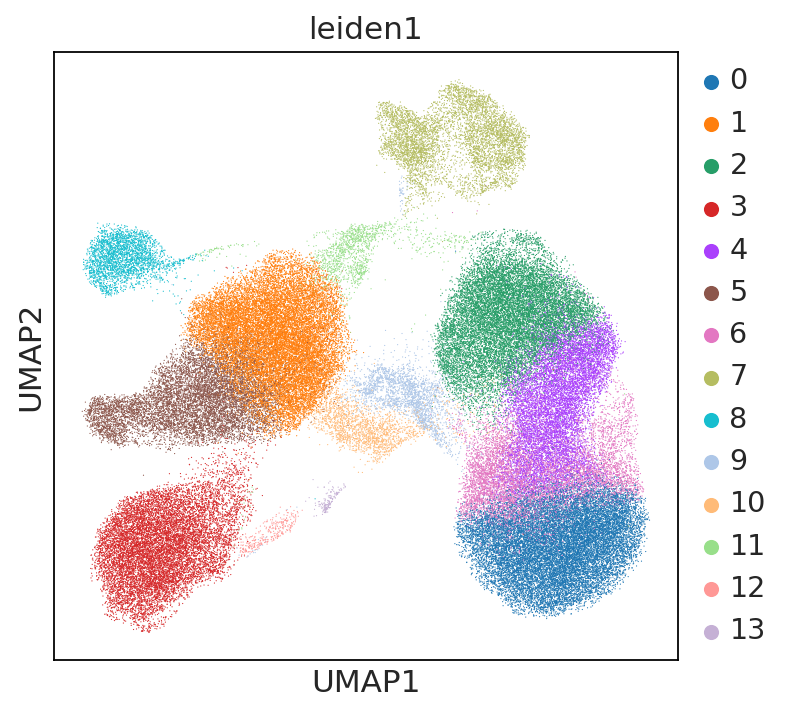

In [60]:
sc.pl.umap(adata,color='leiden1')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


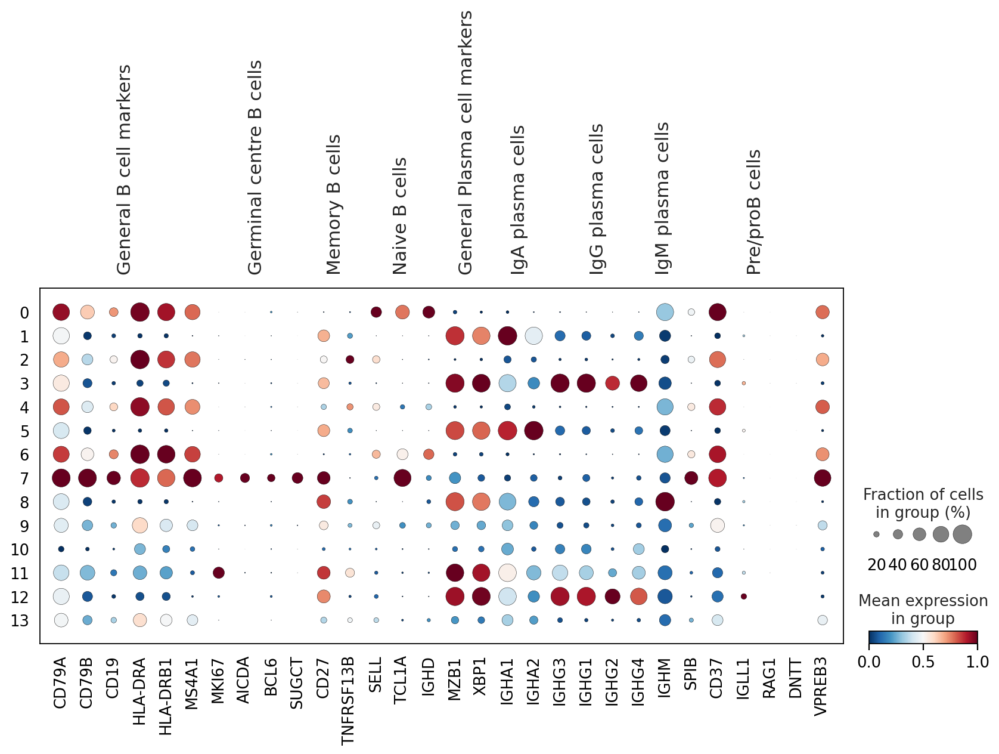

In [61]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

In [62]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,B_GC_I,B_GC_II,B_memory,B_naive,B_plasma_IgA1,B_plasma_IgA2,B_plasma_IgG,B_plasma_IgM,B_plasmablast,B_proB,Doublets,Unknown
leiden1,,,,,,,,,,,,
0,0,0,3,18019,0,0,0,0,0,0,11,283
1,0,0,0,0,17266,0,0,0,0,1,128,777
2,0,0,14443,5,1,0,0,0,0,0,48,434
3,0,0,0,0,14,0,11063,0,8,0,149,795
4,0,0,6401,1209,0,0,0,0,0,0,53,2707
5,0,0,0,0,7077,1385,0,0,0,0,108,841
6,0,0,167,6675,0,0,0,0,0,0,90,1140
7,2209,1942,4,4,4,0,0,0,0,0,266,1213
8,0,0,0,0,1,0,0,2508,11,0,51,271


In [85]:
unknown_adata = adata[adata.obs['fine_predicted_labels_uncertflagged'].isin(['Unknown'])].copy()

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


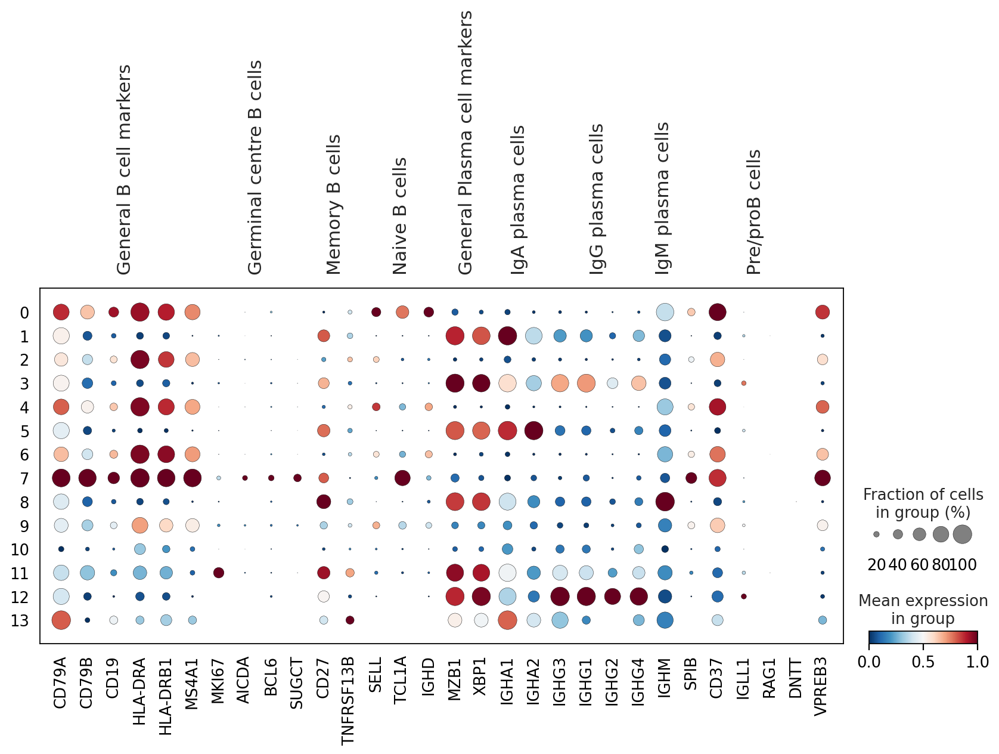

In [64]:
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

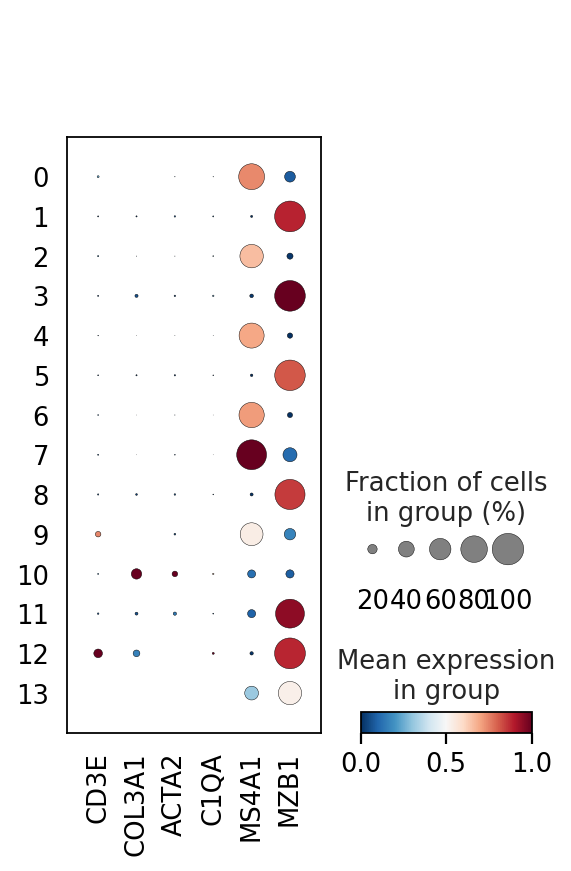

In [65]:
#plot some doublet markers
sc.pl.dotplot(unknown_adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

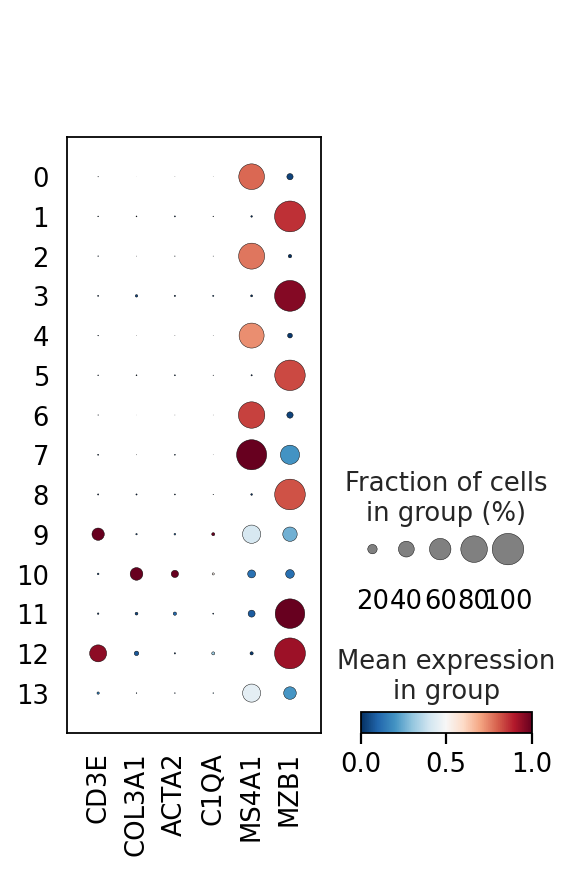

In [66]:
#plot some doublet markers
sc.pl.dotplot(adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


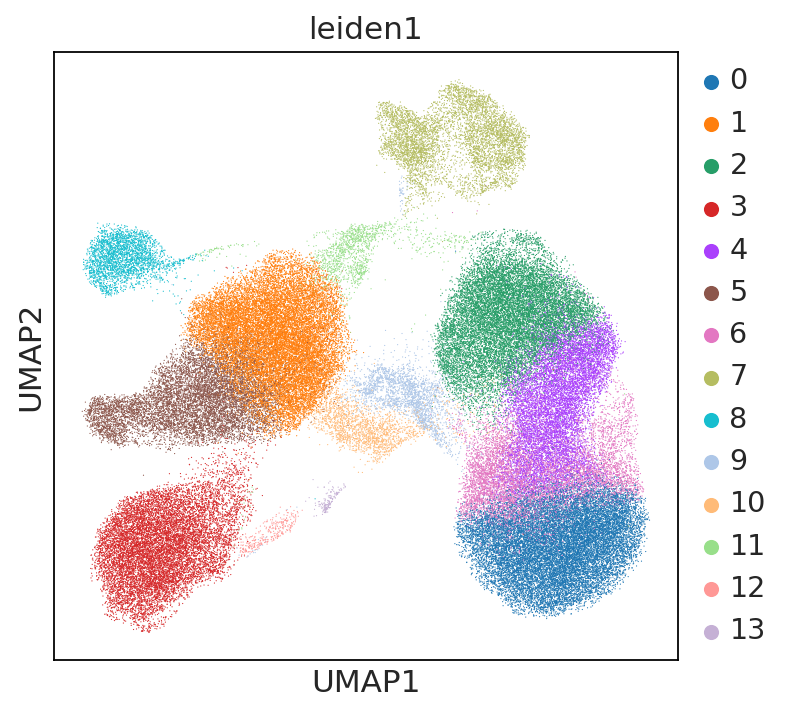

In [67]:
sc.pl.umap(adata,color='leiden1')

In [72]:
adata.X.max()

9.079593

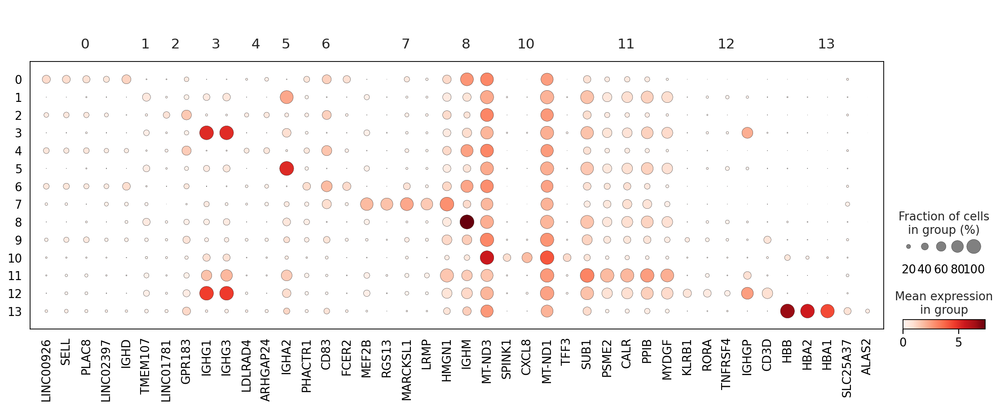

In [68]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden1")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden1', mks=mks)

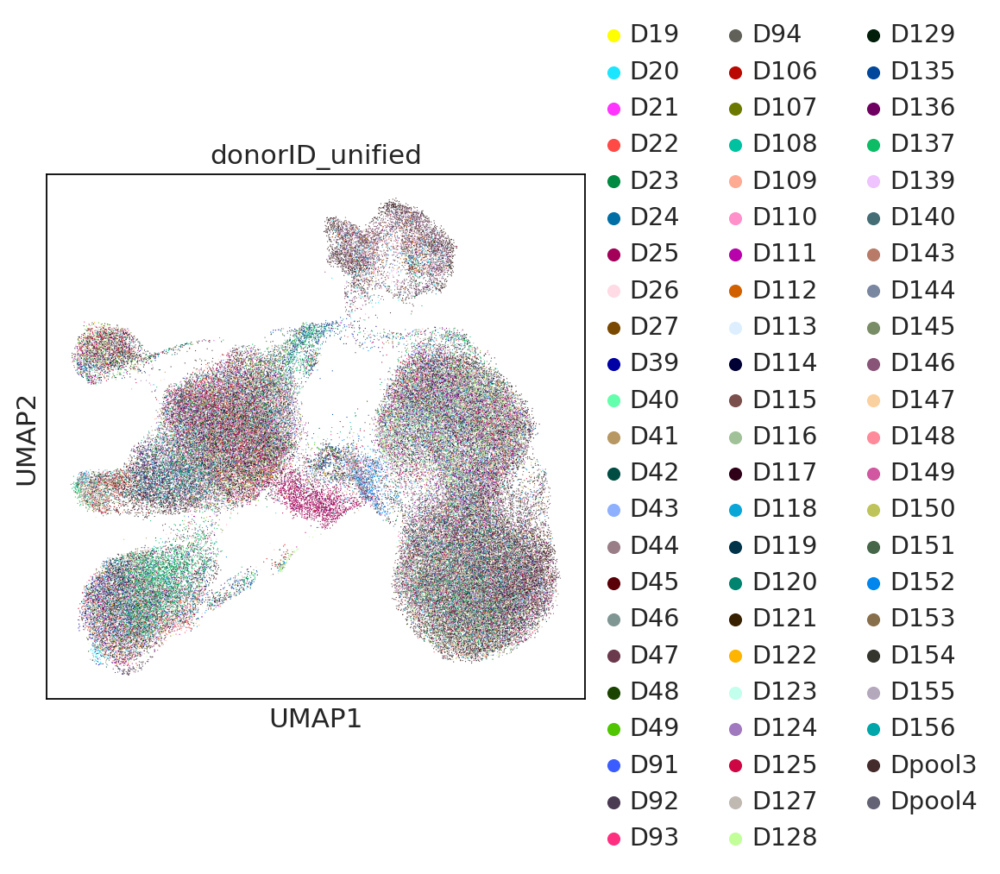

In [73]:
sc.pl.umap(adata,color='donorID_unified')

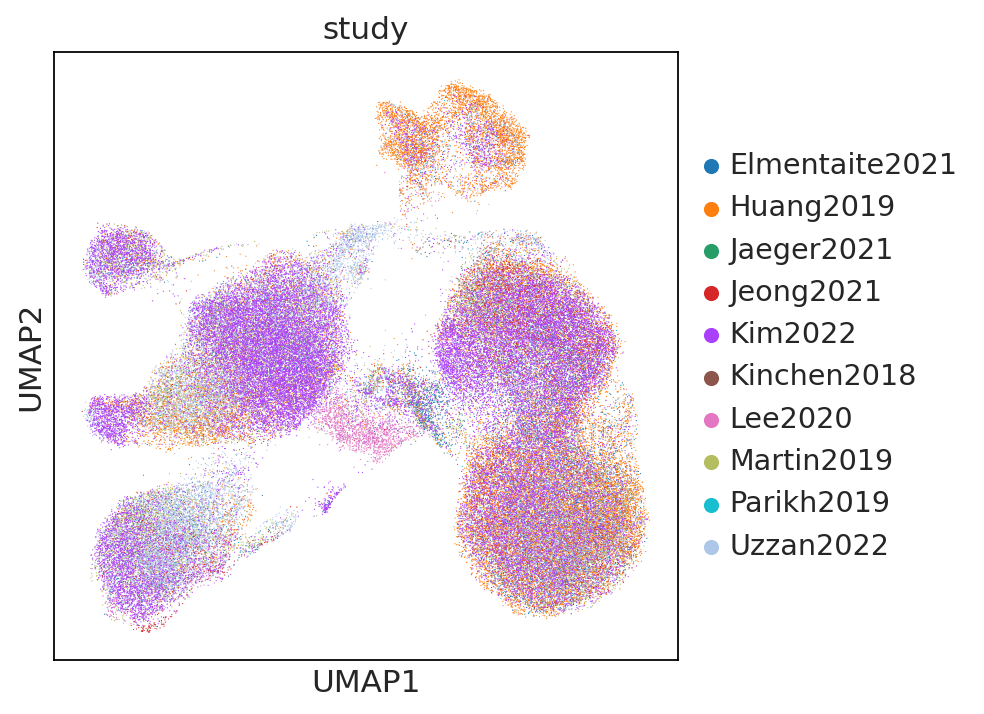

In [74]:
sc.pl.umap(adata,color='study')

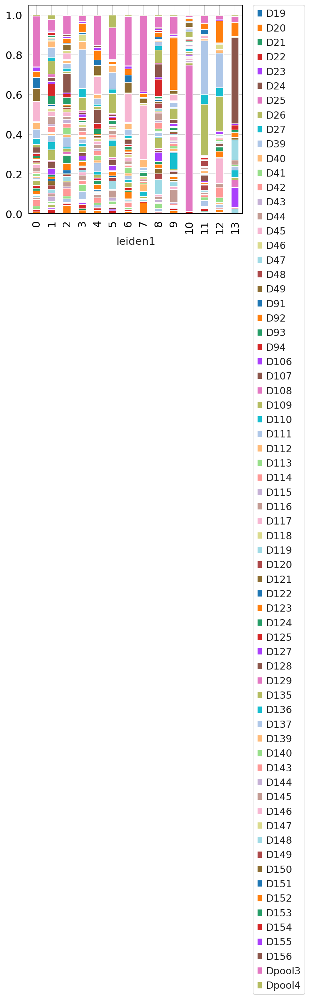

In [75]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

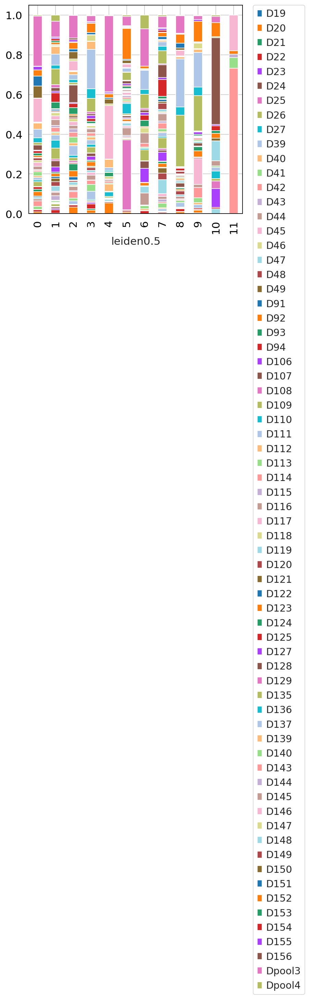

In [81]:
tmp = pd.crosstab(adata.obs['leiden0.5'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

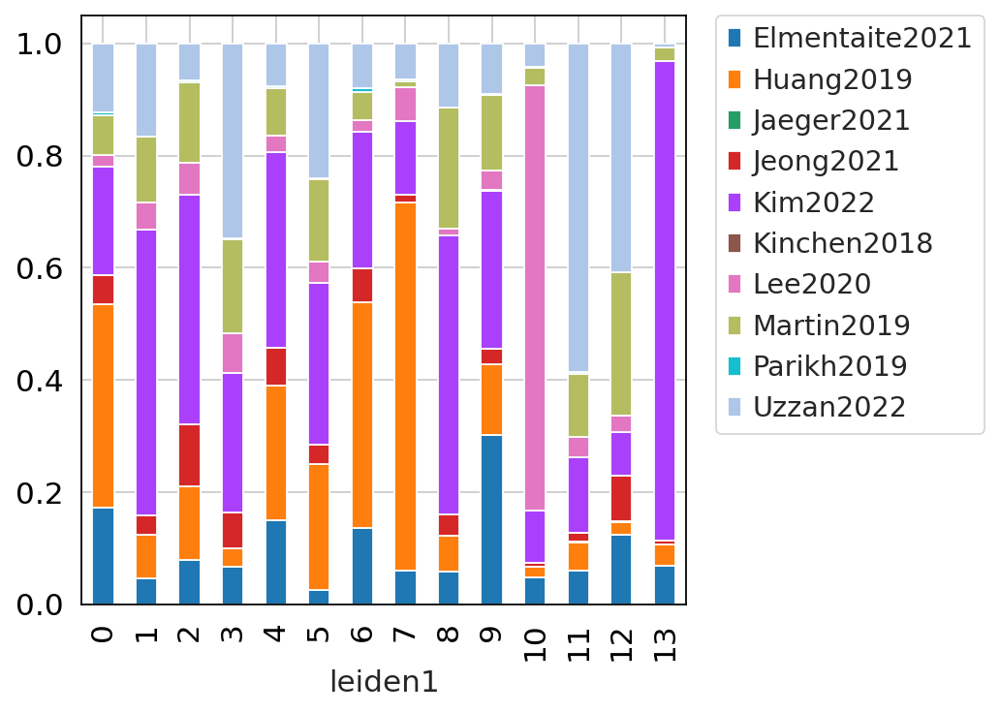

In [83]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['study'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

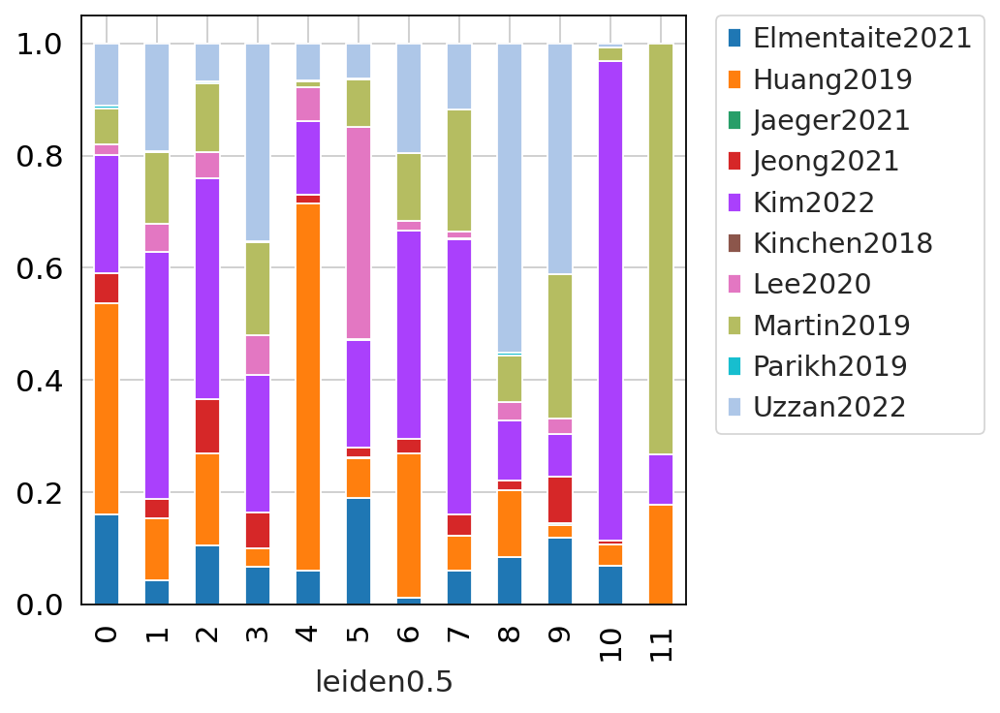

In [82]:
tmp = pd.crosstab(adata.obs['leiden0.5'], adata.obs['study'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

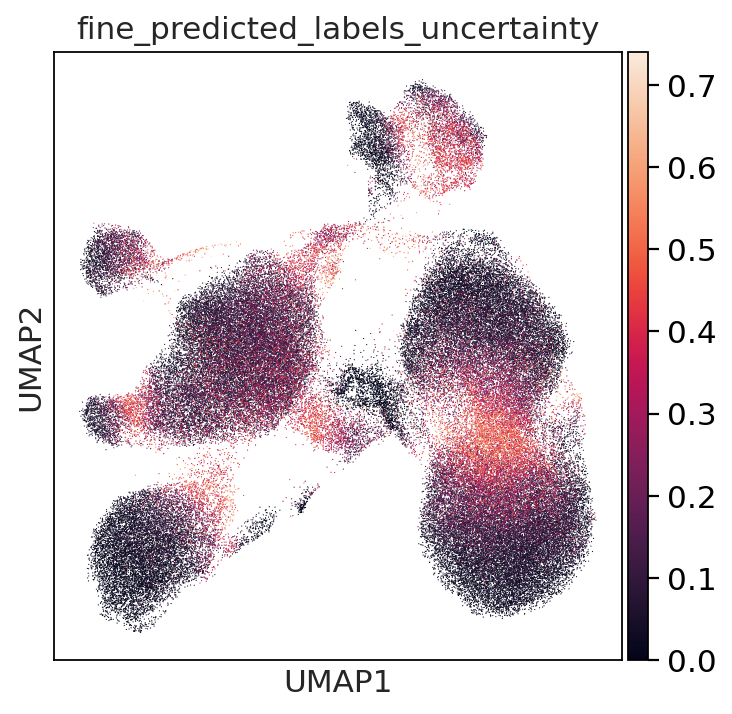

In [76]:
sc.pl.umap(adata,color='fine_predicted_labels_uncertainty')

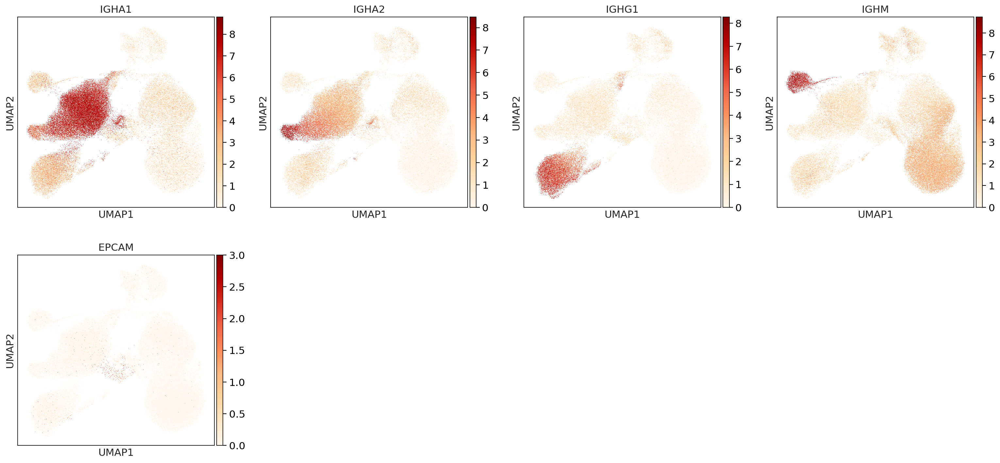

In [78]:
sc.pl.umap(adata,color=['IGHA1','IGHA2','IGHG1','IGHM','EPCAM'],cmap='OrRd')

In [79]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,B_GC_I,B_GC_II,B_memory,B_naive,B_plasma_IgA1,B_plasma_IgA2,B_plasma_IgG,B_plasma_IgM,B_plasmablast,B_proB,Doublets,Unknown
leiden1,,,,,,,,,,,,
0,0,0,3,18019,0,0,0,0,0,0,11,283
1,0,0,0,0,17266,0,0,0,0,1,128,777
2,0,0,14443,5,1,0,0,0,0,0,48,434
3,0,0,0,0,14,0,11063,0,8,0,149,795
4,0,0,6401,1209,0,0,0,0,0,0,53,2707
5,0,0,0,0,7077,1385,0,0,0,0,108,841
6,0,0,167,6675,0,0,0,0,0,0,90,1140
7,2209,1942,4,4,4,0,0,0,0,0,266,1213
8,0,0,0,0,1,0,0,2508,11,0,51,271


In [69]:
#quick look at leiden resolution 0.5
sc.tl.leiden(adata,resolution=0.5,key_added='leiden0.5')

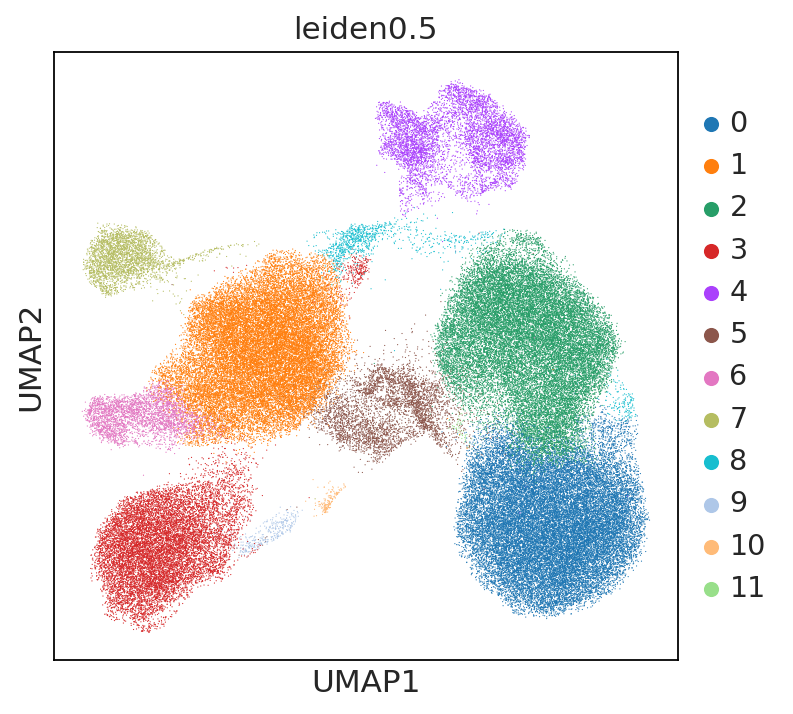

In [70]:
sc.pl.umap(adata,color='leiden0.5')

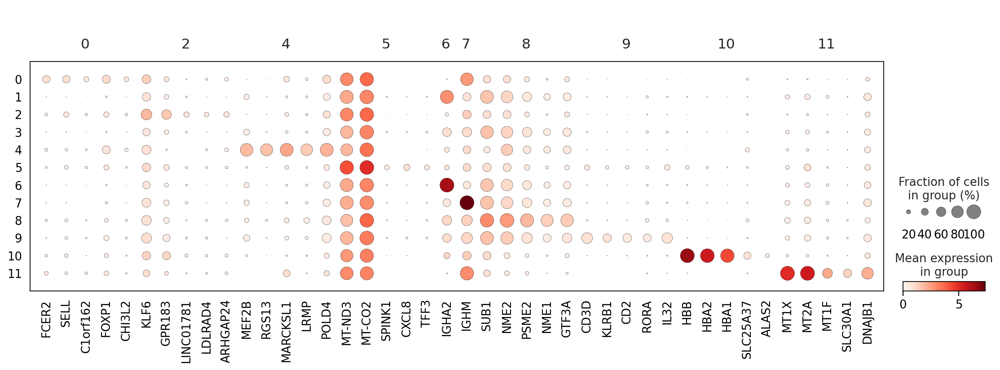

In [71]:
mkst = calc_marker_stats(adata, groupby="leiden0.5")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden0.5', mks=mks)

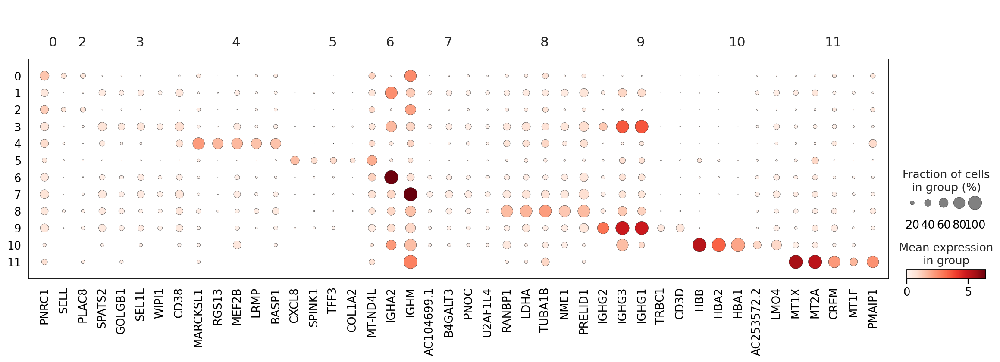

In [86]:
mkst = calc_marker_stats(unknown_adata, groupby="leiden0.5")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(unknown_adata, groupby='leiden0.5', mks=mks)

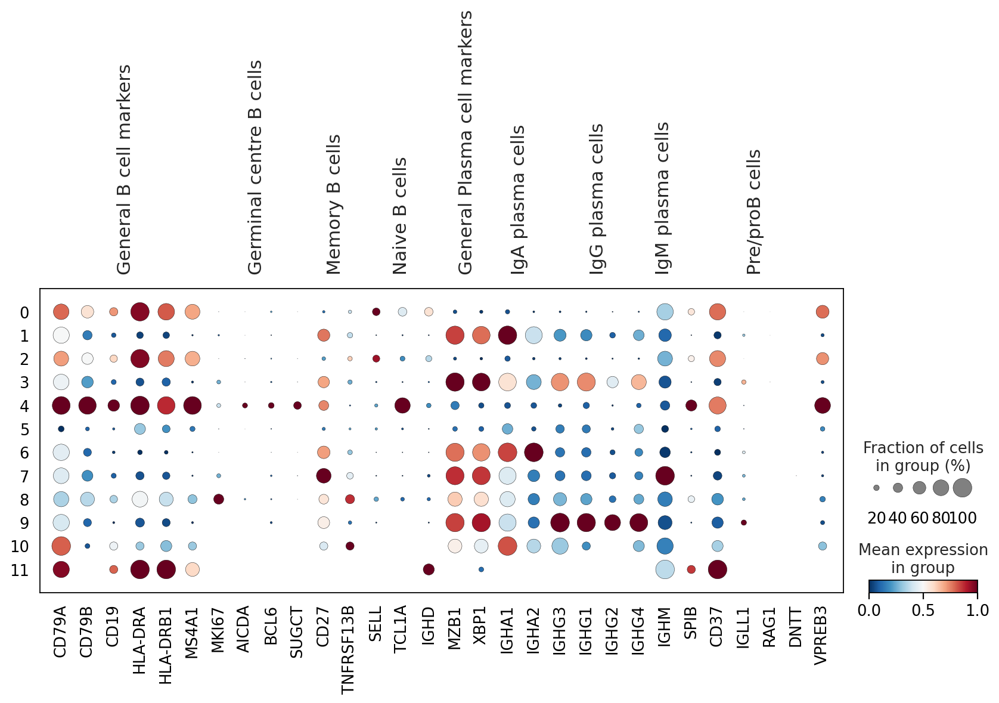

In [87]:
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden0.5',color_map='RdBu_r', standard_scale='var')

In [80]:
pd.crosstab(adata.obs['leiden0.5'],adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,B_GC_I,B_GC_II,B_memory,B_naive,B_plasma_IgA1,B_plasma_IgA2,B_plasma_IgG,B_plasma_IgM,B_plasmablast,B_proB,Doublets,Unknown
leiden0.5,,,,,,,,,,,,
0,0,0,80,25680,0,0,0,0,0,0,75,1815
1,0,0,0,0,23217,1,0,0,0,1,214,1198
2,0,0,20896,175,1,0,0,0,0,0,113,2730
3,0,0,0,0,14,0,11067,0,36,0,170,1000
4,2210,1942,4,3,2,0,0,0,0,0,302,1215
5,0,0,3,5,220,0,0,0,0,0,3414,785
6,0,0,0,0,1347,1384,0,0,0,0,43,526
7,0,0,0,0,2,0,0,2510,10,0,51,333
8,47,0,69,65,41,0,0,0,3,0,422,491


In [89]:
#Use Leiden resolution 0.5
unknown = adata.obs[['leiden0.5','fine_predicted_labels_uncertflagged']]
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [90]:
#for B cells using leiden0.5 because the clustering makes more sense to the total annotated cell types
unknown['fine_predicted_labels_resolved'] = (unknown['leiden0.5']
        .map(lambda x:{'0':'B_naive',
                       '1':'B_plasma_IgA1',
                       '2':'B_memory',
                       '3':'B_plasma_IgG', 
                       '4':'GC', #both GCI and II, need to further subcluster to split up, this is GC B cells were annotated in the healthy reference
                       '5':'Doublets', 
                       '6':'B_plasma_IgA2', #possibly also needs further refinement
                       '7':'B_plasma_IgM',
                       '8':'B_plasmablast', #from a study that focused on plasmablasts 
                       '9':'Doublets',
                       '10':'Doublets',
                       '11':'Doublets'
                         }.get(x,x)).astype('category'))

In [91]:
unknown

,leiden0.5,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,,
AAACGGGTCCTGTAGA-4918STDY7273964,0,Unknown,B_naive
AAAGATGTCAACGAAA-4918STDY7273964,4,Unknown,GC
AAAGCAAGTGTTTGGT-4918STDY7273964,2,Unknown,B_memory
AACACGTAGTTCCACA-4918STDY7273964,2,Unknown,B_memory
AACCATGCAATCACAC-4918STDY7273964,0,Unknown,B_naive
...,...,...,...
TAGAGCTCATTGGGCC-GSM4546346,1,Unknown,B_plasma_IgA1
TGGACGCGTATAGGGC-GSM4546346,6,Unknown,B_plasma_IgA2
TGGGCGTTCCGCAAGC-GSM4546346,6,Unknown,B_plasma_IgA2


In [92]:
adata

AnnData object with n_obs × n_vars = 106472 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

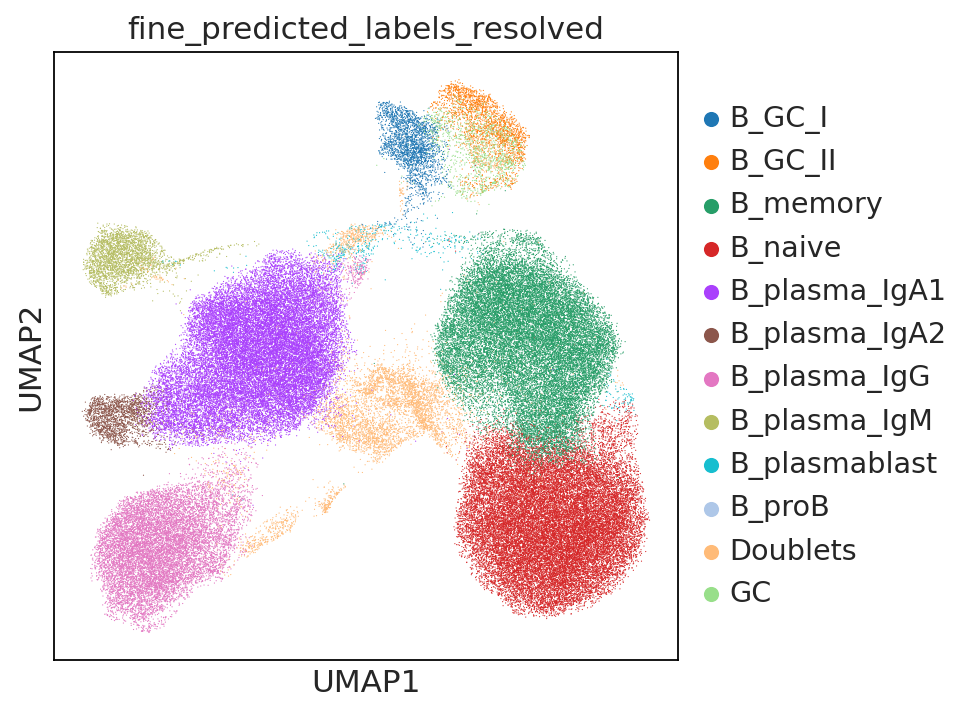

In [111]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

In [94]:
no_doublets = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Doublets'])].copy()

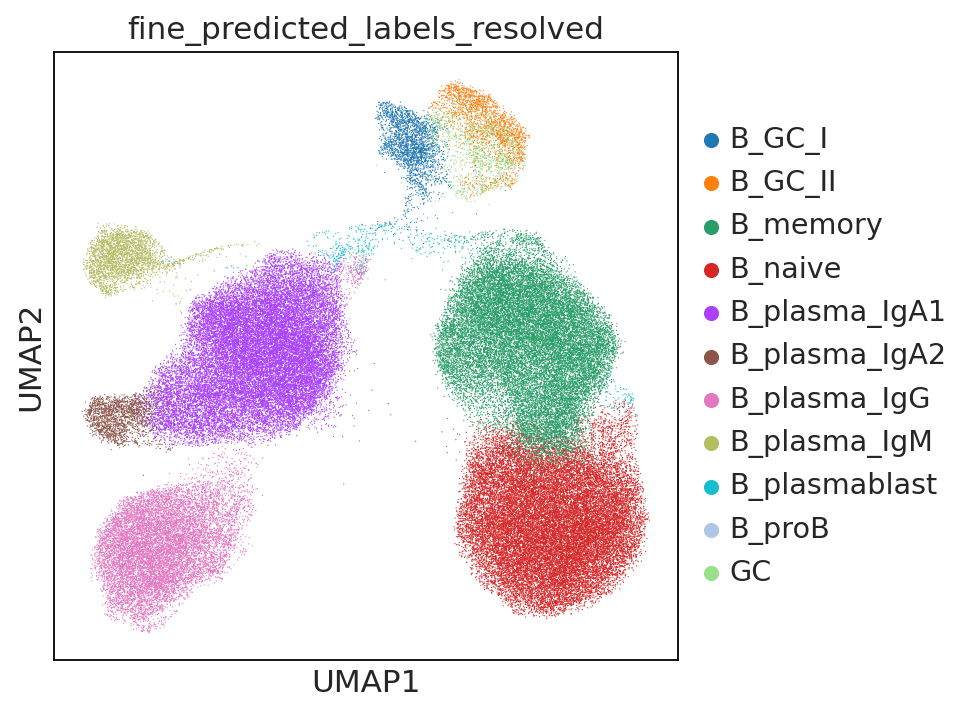

In [95]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved')

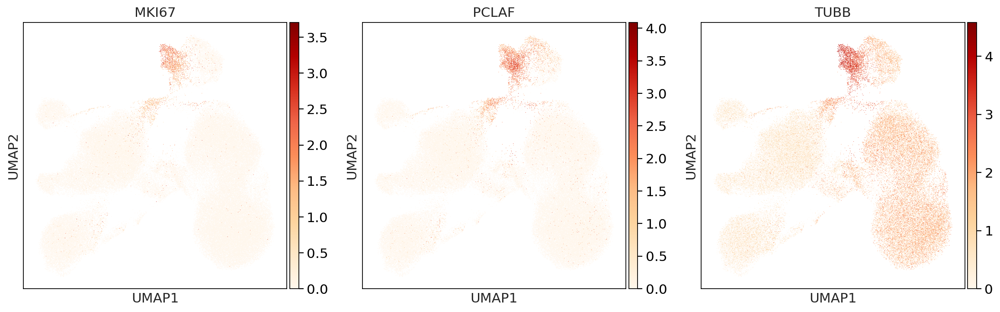

In [97]:
sc.pl.umap(adata,color=['MKI67','PCLAF','TUBB'],cmap='OrRd')

In [98]:
#subcluster germinal centre B cells to finalise annotations
gc = adata[adata.obs.fine_predicted_labels_resolved.isin(['GC','B_GC_I','B_GC_II'])].copy()

In [99]:
gc

AnnData object with n_obs × n_vars = 5414 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [100]:
sc.pp.neighbors(gc, use_rep="X_scANVI")
sc.tl.umap(gc)

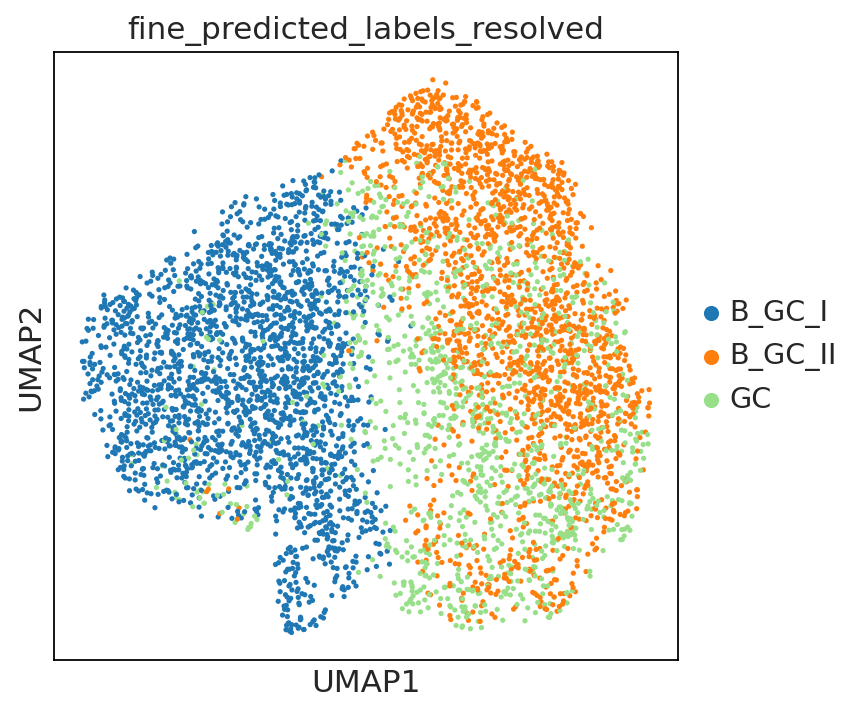

In [101]:
sc.pl.umap(gc,color='fine_predicted_labels_resolved')

In [102]:
sc.tl.leiden(gc, resolution=0.2)

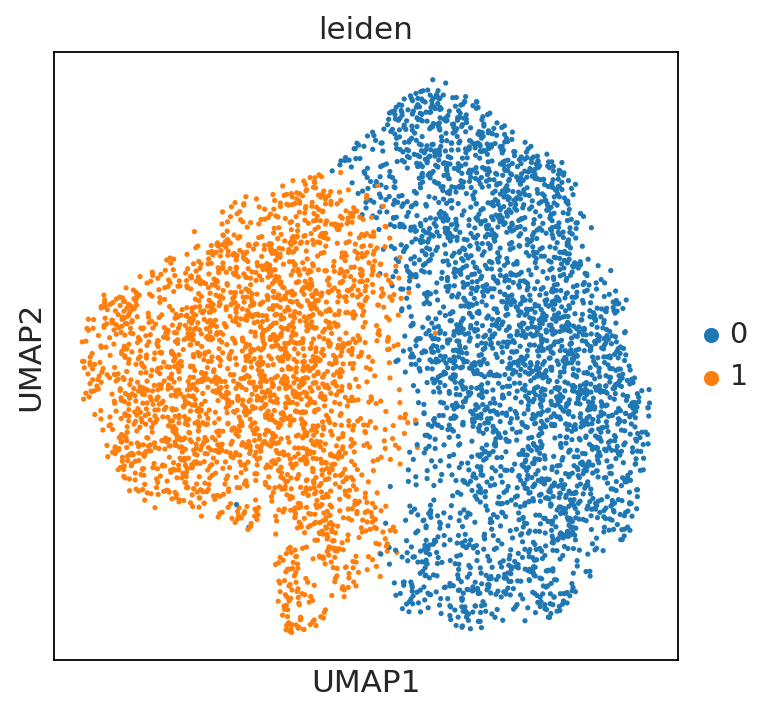

In [103]:
sc.pl.umap(gc,color='leiden')

In [105]:
unknowngc = gc.obs[['leiden','fine_predicted_labels_uncertflagged']]
unknowngc = unknowngc[unknowngc['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [106]:
pd.crosstab(gc.obs['leiden'],gc.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,B_GC_I,B_GC_II,Unknown
leiden,,,
0,9,1915,992
1,2248,27,223


In [113]:
unknowngc['fine_predicted_labels_resolved'] = (unknowngc['leiden']
        .map(lambda x:{'0':'B_GC_II',
                       '1':'B_GC_I'
                         }.get(x,x)).astype('category'))

In [114]:
unknowngc

,leiden,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,,
AAAGATGTCAACGAAA-4918STDY7273964,1,Unknown,B_GC_I
AAGACCTTCGTTTATC-4918STDY7273964,0,Unknown,B_GC_II
ACGCCAGGTTCAGGCC-4918STDY7273964,0,Unknown,B_GC_II
ATCCACCAGGGTGTGT-4918STDY7273964,0,Unknown,B_GC_II
CAACTAGAGCTGCGAA-4918STDY7273964,0,Unknown,B_GC_II
...,...,...,...
TCTCATACACCGTTGG-GSM4546337,0,Unknown,B_GC_II
TGAGCATTCAACCAAC-GSM4546337,0,Unknown,B_GC_II
TTCTCAAAGGCGATAC-GSM4546337,0,Unknown,B_GC_II


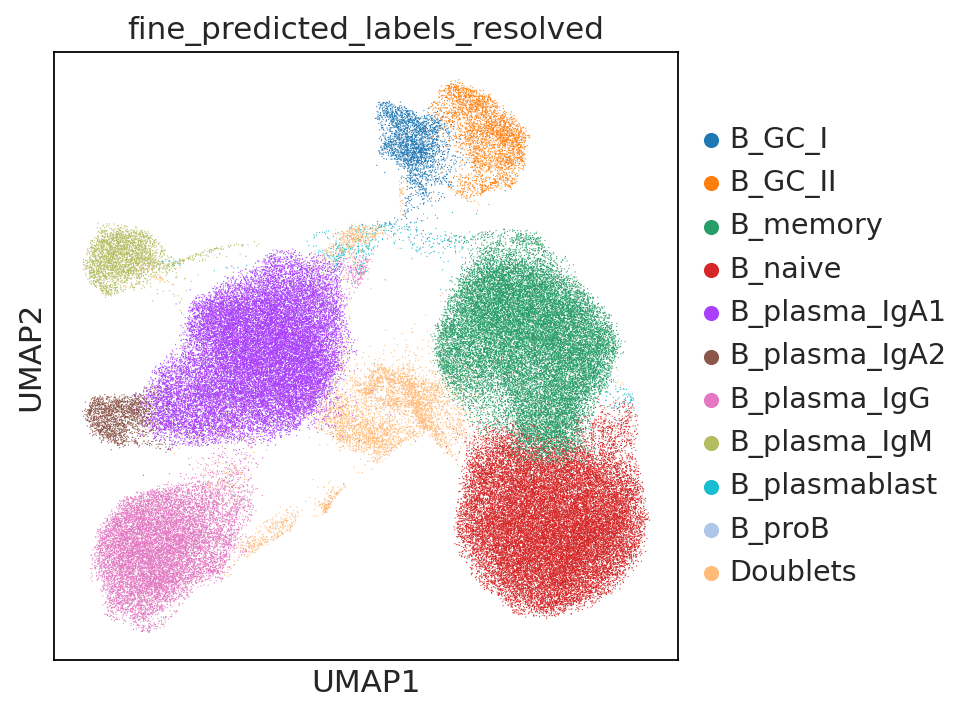

In [115]:
ON = {O:N for O,N in zip(unknowngc.index,unknowngc["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_resolved"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

In [116]:
#clean up plasmablasts
pb = adata[adata.obs.fine_predicted_labels_resolved.isin(['Doublets','B_plasma_IgG','B_plasmablast','B_plasma_IgM'])].copy()

In [117]:
sc.pp.neighbors(pb, use_rep="X_scANVI")
sc.tl.umap(pb)

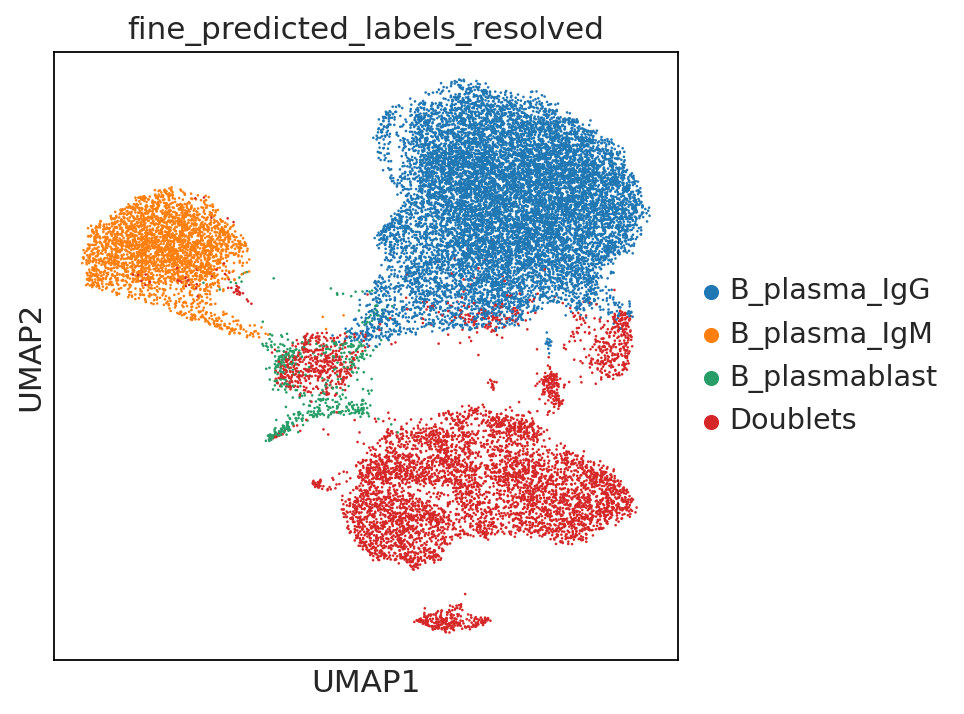

In [118]:
sc.pl.umap(pb,color='fine_predicted_labels_resolved')

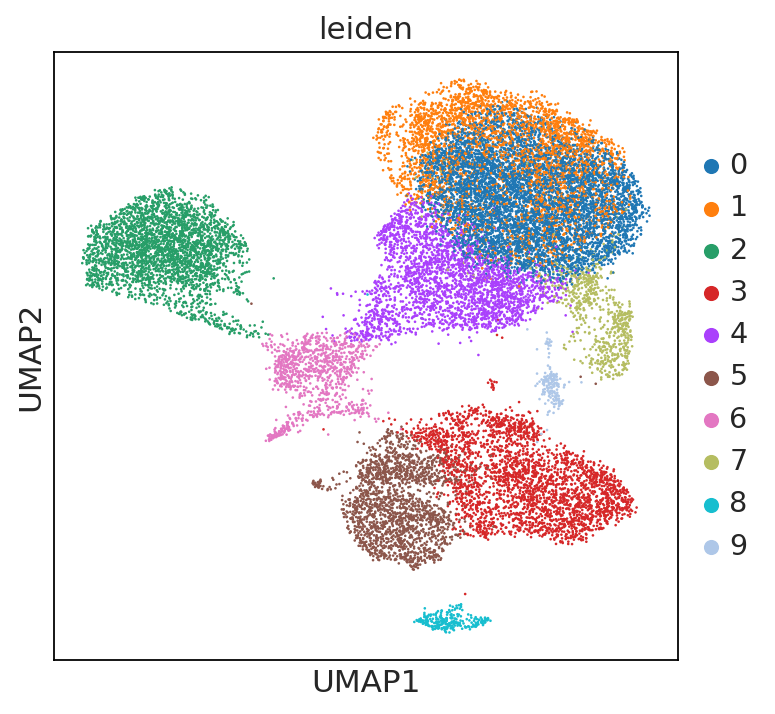

In [119]:
sc.tl.leiden(pb, resolution=0.5)
sc.pl.umap(pb,color='leiden')

In [122]:
pb

AnnData object with n_obs × n_vars = 21574 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

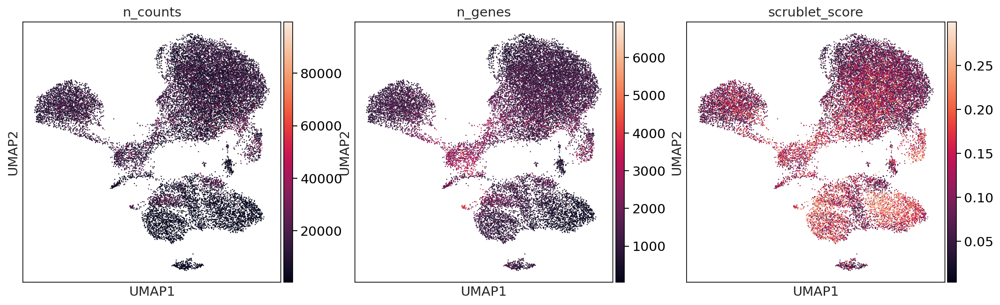

In [124]:
sc.pl.umap(pb,color=['n_counts','n_genes','scrublet_score'])

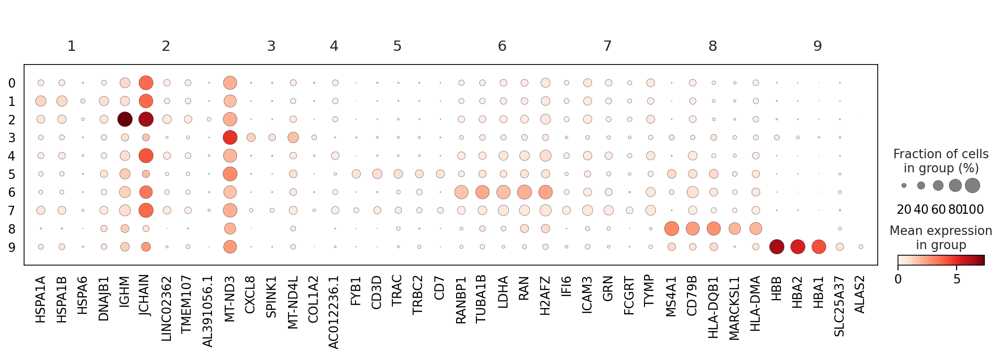

In [120]:
mkst = calc_marker_stats(pb, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(pb, groupby='leiden', mks=mks)

In [125]:
#reannotate cluster 6 as plasmablasts?
pb1 = pb[pb.obs.leiden.isin(['6'])].copy()

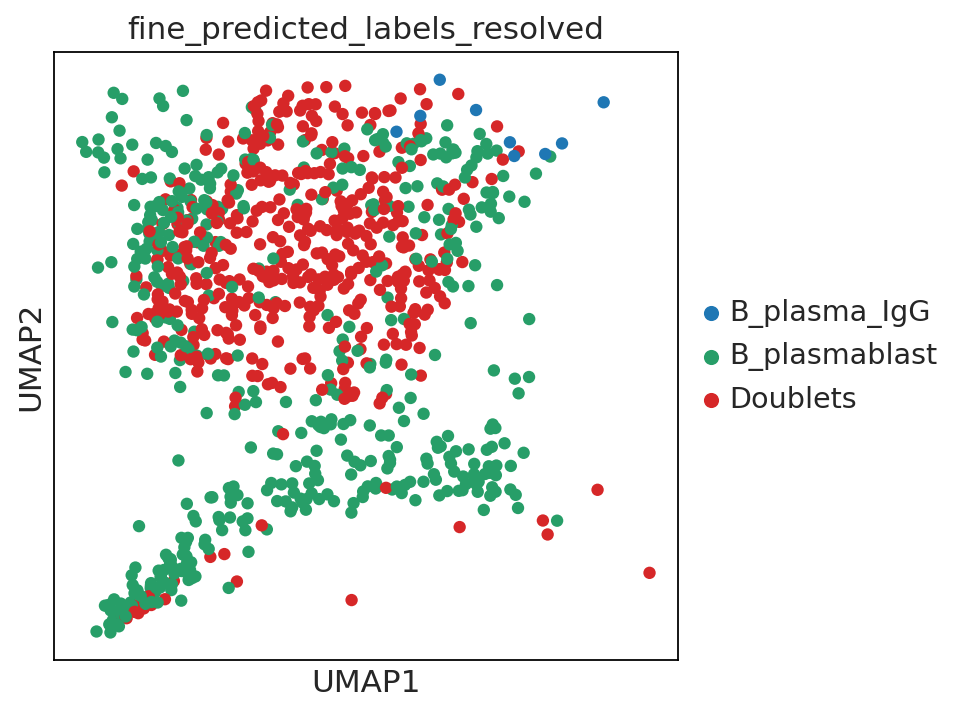

In [127]:
sc.pl.umap(pb1,color='fine_predicted_labels_resolved')

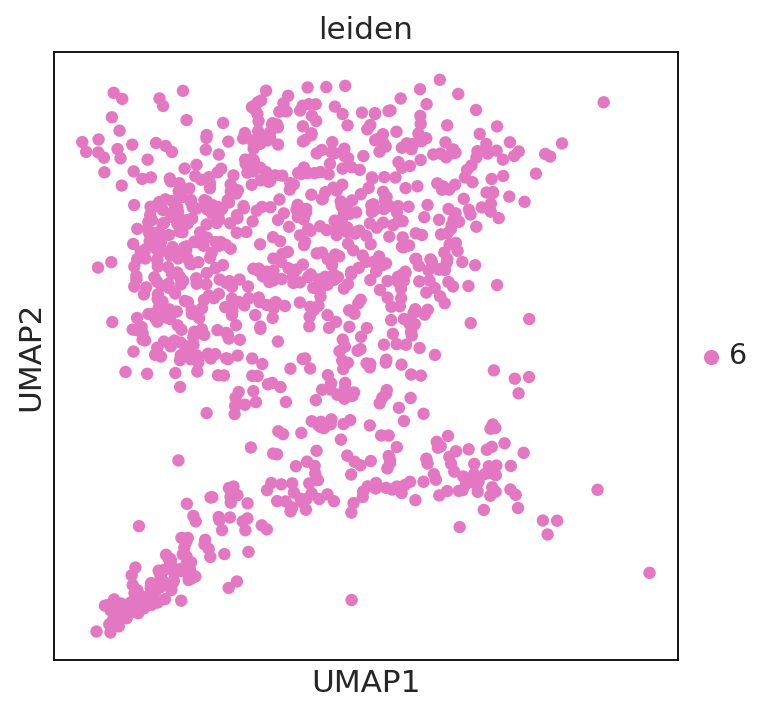

In [135]:
sc.pl.umap(pb1,color='leiden')

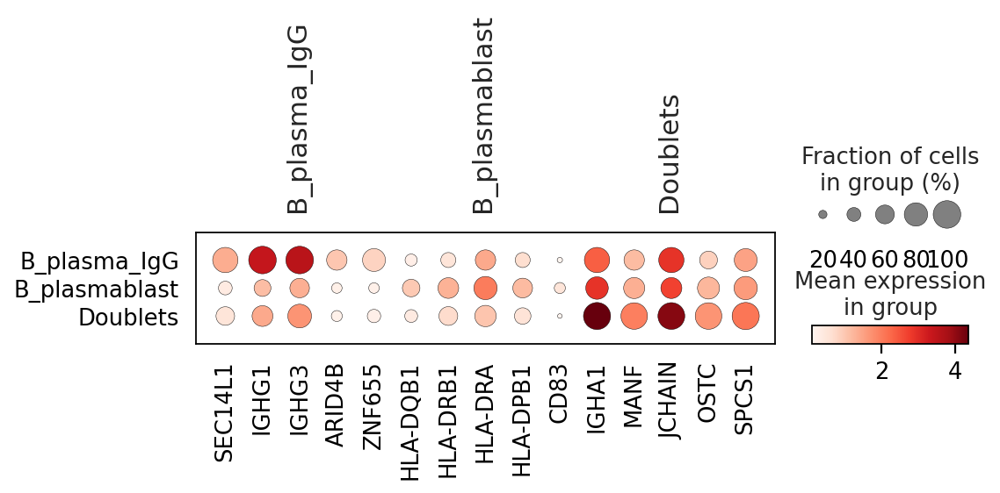

In [129]:
mkst = calc_marker_stats(pb1, groupby="fine_predicted_labels_resolved")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(pb1, groupby='fine_predicted_labels_resolved', mks=mks)

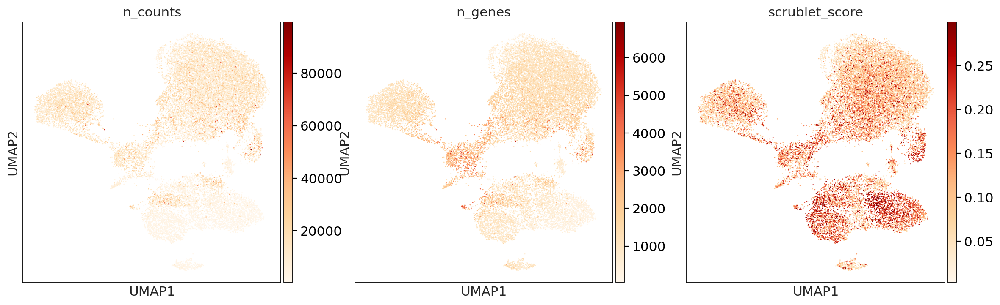

In [130]:
sc.pl.umap(pb,color=['n_counts','n_genes','scrublet_score'],cmap='OrRd')

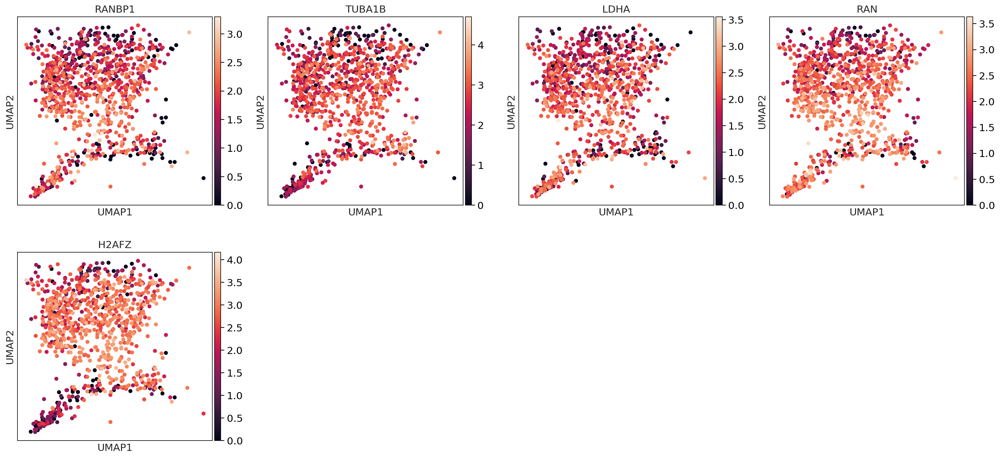

In [131]:
sc.pl.umap(pb1,color=['RANBP1','TUBA1B','LDHA','RAN','H2AFZ'])

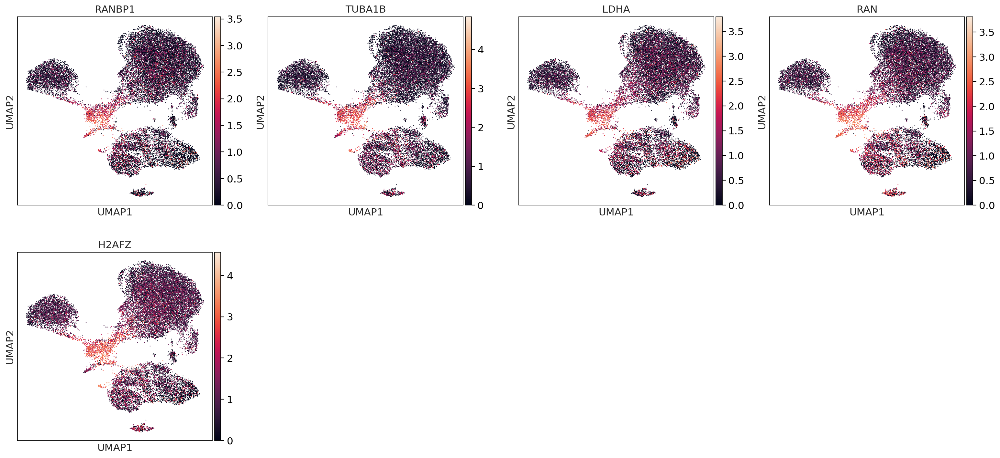

In [132]:
sc.pl.umap(pb,color=['RANBP1','TUBA1B','LDHA','RAN','H2AFZ'])

In [136]:
pb1.obs['fine_predicted_labels_resolved'] = (pb1.obs['leiden']
        .map(lambda x:{'6':'B_plasmablast'
                         }.get(x,x)).astype('category'))

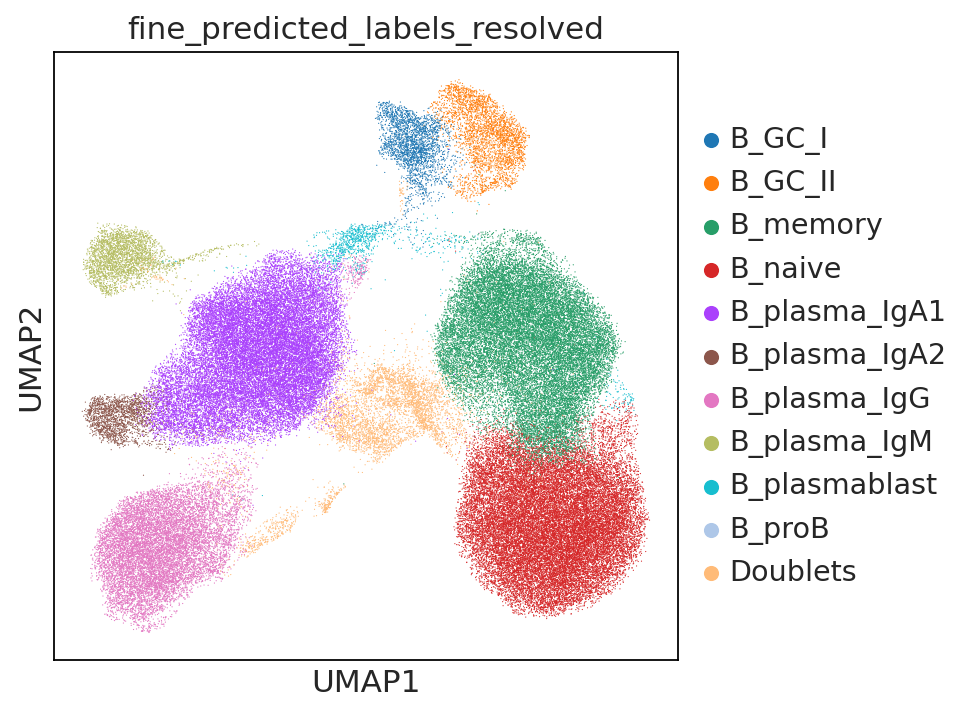

In [137]:
ON = {O:N for O,N in zip(pb1.obs_names,pb1.obs["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_resolved"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

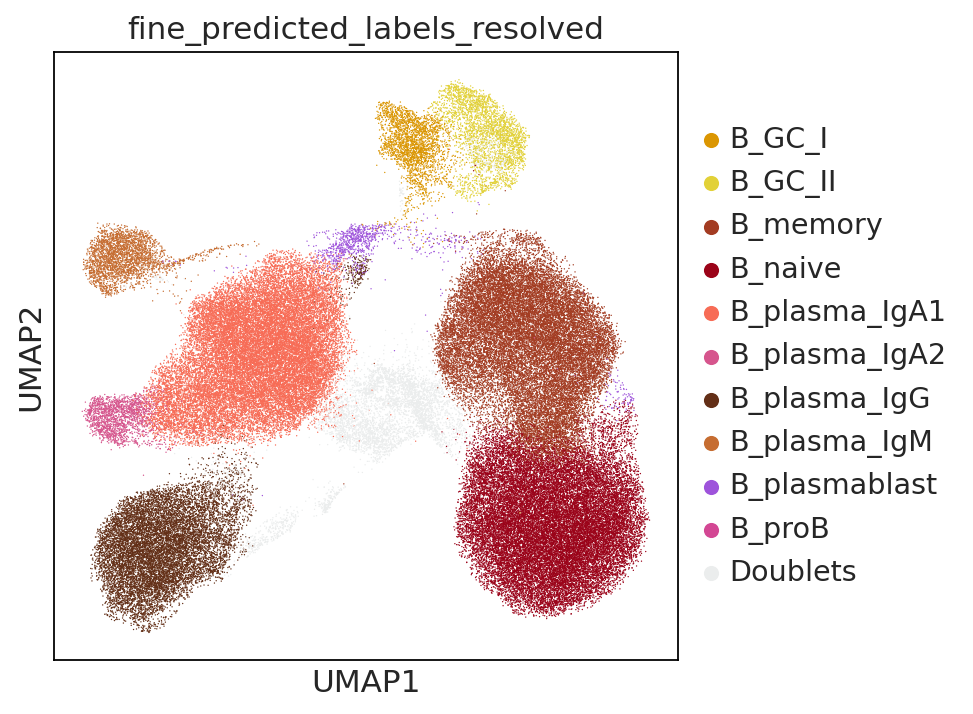

In [138]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#db9602', #B_GC_I
'#e2d138', #B_GC_II
'#a33c22',#B_memory
'#9b0319', #B_naive
'#f76c56',#B_plasma_IgA1
'#d6558d',#B_plasma_IgA2
'#632f17',#B_plasma_IgG                            
'#c66d31',#B_plasma_IgM
'#9e53db',#B_plasmablast
#'#8a4682',#B_preB
'#d34794',#pro b
                                                            '#ebeded',#doublets
                                                                       
                                                       
                                               
                                               
    
    
                                              ],size=1.5)

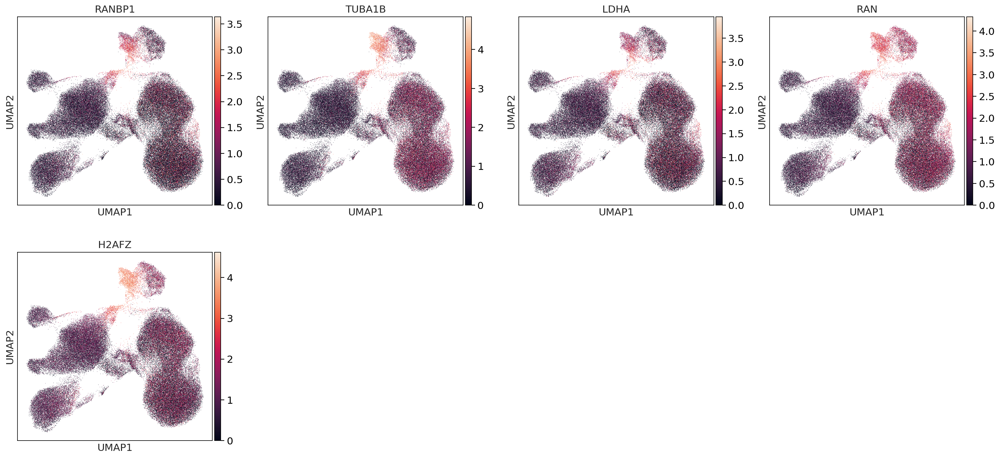

In [139]:
sc.pl.umap(adata,color=['RANBP1','TUBA1B','LDHA','RAN','H2AFZ'])

In [140]:
#clean up igg
igg = adata[adata.obs.fine_predicted_labels_resolved.isin(['B_plasma_IgG'])].copy()

In [141]:
sc.pp.neighbors(igg, use_rep="X_scANVI")
sc.tl.umap(igg)

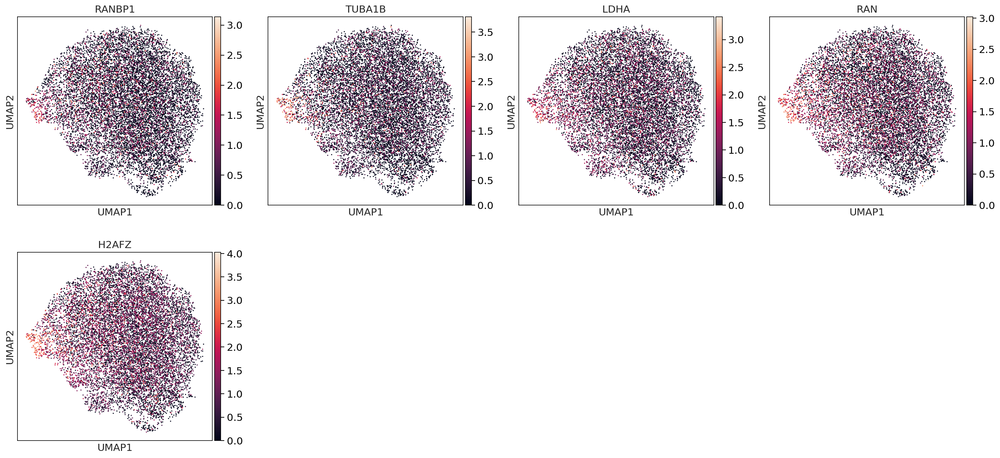

In [142]:
sc.pl.umap(igg,color=['RANBP1','TUBA1B','LDHA','RAN','H2AFZ'])

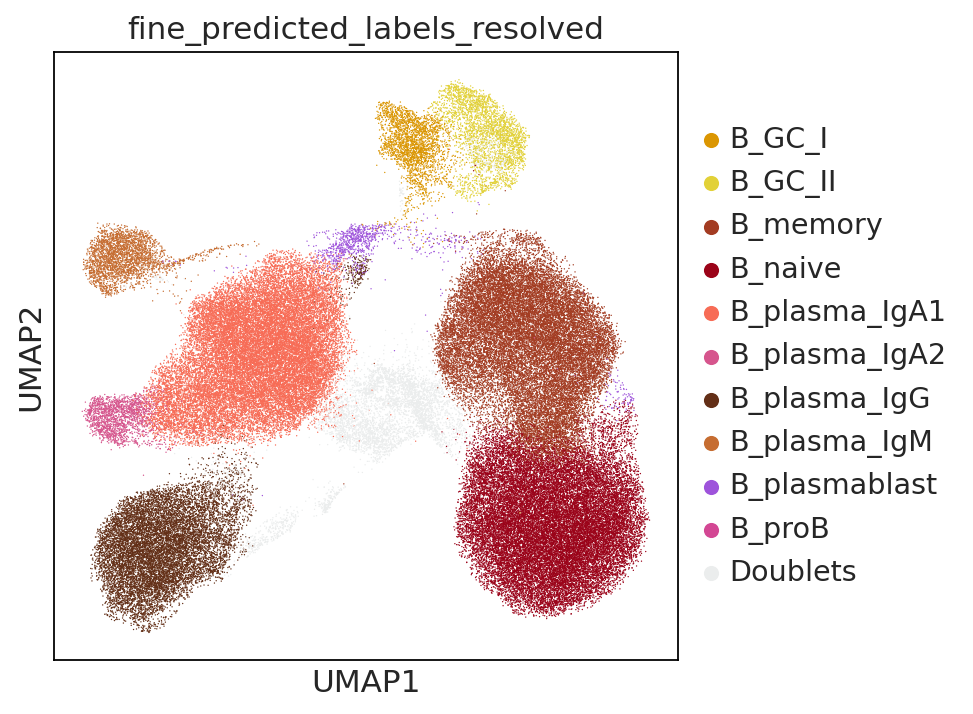

In [143]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#db9602', #B_GC_I
'#e2d138', #B_GC_II
'#a33c22',#B_memory
'#9b0319', #B_naive
'#f76c56',#B_plasma_IgA1
'#d6558d',#B_plasma_IgA2
'#632f17',#B_plasma_IgG                            
'#c66d31',#B_plasma_IgM
'#9e53db',#B_plasmablast
#'#8a4682',#B_preB
'#d34794',#pro b
                                                            '#ebeded',#doublets
                                                                       
                                                       
                                               
                                               
    
    
                                              ],size=1.5)

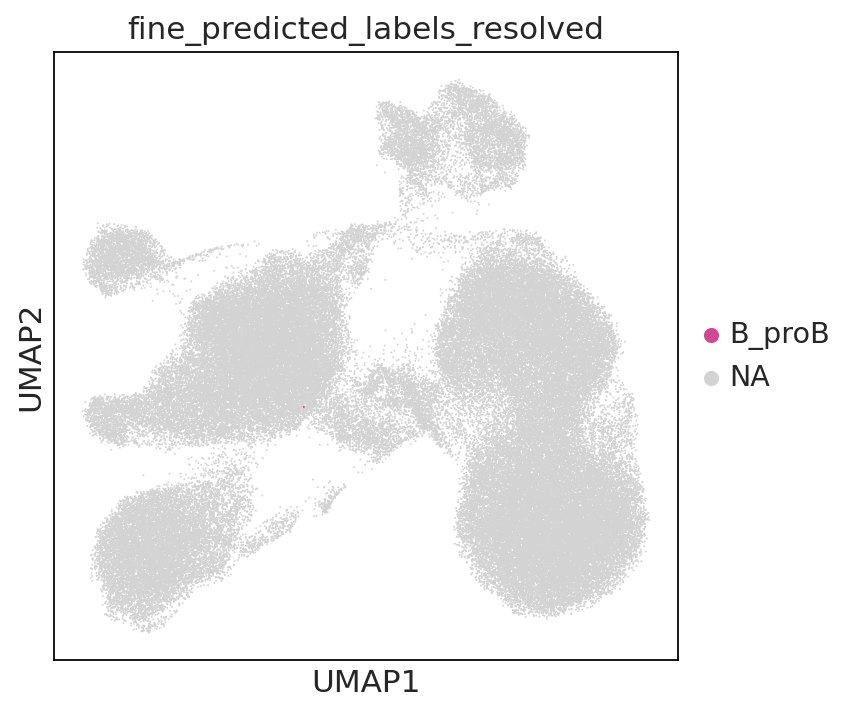

In [145]:
sc.pl.umap(adata,color='fine_predicted_labels_resolved',groups='B_proB',size=3)

In [146]:
adata.obs.fine_predicted_labels_resolved.value_counts()

B_naive          27747
B_plasma_IgA1    26042
B_memory         23783
B_plasma_IgG     12096
Doublets          5615
B_GC_II           2934
B_plasma_IgM      2843
B_GC_I            2480
B_plasma_IgA2     1911
B_plasmablast     1020
B_proB               1
Name: fine_predicted_labels_resolved, dtype: int64

In [147]:
#proB cell is in IgA cluster, reannotate as such
adata.obs['fine_predicted_labels_resolved'] = (adata.obs['fine_predicted_labels_resolved']
        .map(lambda x:{'B_proB':'B_plasma_IgA1'
                         }.get(x,x)).astype('category'))

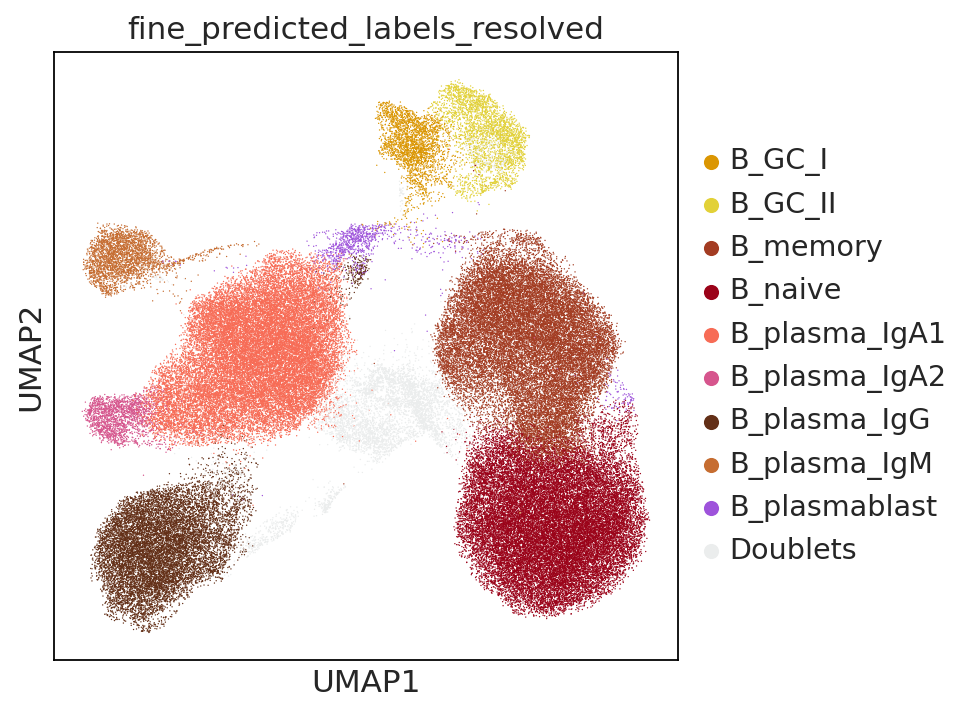

In [148]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#db9602', #B_GC_I
'#e2d138', #B_GC_II
'#a33c22',#B_memory
'#9b0319', #B_naive
'#f76c56',#B_plasma_IgA1
'#d6558d',#B_plasma_IgA2
'#632f17',#B_plasma_IgG                            
'#c66d31',#B_plasma_IgM
'#9e53db',#B_plasmablast
#'#8a4682',#B_preB
#'#d34794',#pro b
                                                            '#ebeded',#doublets
                                                                       
                                                       
                                               
                                               
    
    
                                              ],size=1.5)

In [149]:
annot = adata.obs[['fine_predicted_labels_uncertflagged','fine_predicted_labels_resolved']]

In [150]:
annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,
AAACCTGAGAGGTTAT-4918STDY7273964,B_naive,B_naive
AAACGGGAGAGCTGGT-4918STDY7273964,B_naive,B_naive
AAACGGGCACTAAGTC-4918STDY7273964,B_naive,B_naive
AAACGGGGTAAAGGAG-4918STDY7273964,B_GC_II,B_GC_II
AAACGGGGTAGCGATG-4918STDY7273964,B_naive,B_naive
...,...,...
TTTGCGCGTCTGATTG-GSM4546346,B_plasma_IgA1,B_plasma_IgA1
TTTGCGCTCATTGCCC-GSM4546346,B_plasma_IgA1,B_plasma_IgA1
TTTGGTTGTACCTACA-GSM4546346,B_plasma_IgG,B_plasma_IgG


In [152]:
#export final annotations
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/B_disease_annot.csv')